# Restaurant Industry Study 🍽️

In [271]:
# Core Libraries
import pandas as pd
import numpy as np

# Visualization Libraries
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
import folium
from folium.plugins import MarkerCluster

# Data Preprocessing
from sklearn.preprocessing import StandardScaler, MinMaxScaler, LabelBinarizer
from sklearn.model_selection import train_test_split

# Machine Learning Models
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier

# Model Evaluation
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,
    confusion_matrix, classification_report, roc_curve, roc_auc_score
)

# Deep Learning (TensorFlow/Keras)
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import Adam

# Miscellaneous
import unicodedata
import re
from pandas.plotting import parallel_coordinates

In [272]:
data = pd.read_csv('Dataset .csv')
data.head(5)

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,"French, Japanese, Desserts",...,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,314
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,Japanese,...,Botswana Pula(P),Yes,No,No,No,3,4.5,Dark Green,Excellent,591
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Ma...",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",...,Botswana Pula(P),Yes,No,No,No,4,4.4,Green,Very Good,270
3,6318506,Ooma,162,Mandaluyong City,"Third Floor, Mega Fashion Hall, SM Megamall, O...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.056475,14.585318,"Japanese, Sushi",...,Botswana Pula(P),No,No,No,No,4,4.9,Dark Green,Excellent,365
4,6314302,Sambo Kojin,162,Mandaluyong City,"Third Floor, Mega Atrium, SM Megamall, Ortigas...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.057508,14.584450,"Japanese, Korean",...,Botswana Pula(P),Yes,No,No,No,4,4.8,Dark Green,Excellent,229


In [273]:
data.columns

Index(['Restaurant ID', 'Restaurant Name', 'Country Code', 'City', 'Address',
       'Locality', 'Locality Verbose', 'Longitude', 'Latitude', 'Cuisines',
       'Average Cost for two', 'Currency', 'Has Table booking',
       'Has Online delivery', 'Is delivering now', 'Switch to order menu',
       'Price range', 'Aggregate rating', 'Rating color', 'Rating text',
       'Votes'],
      dtype='object')

In [274]:
data.shape

(9551, 21)

In [275]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9551 entries, 0 to 9550
Data columns (total 21 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Restaurant ID         9551 non-null   int64  
 1   Restaurant Name       9551 non-null   object 
 2   Country Code          9551 non-null   int64  
 3   City                  9551 non-null   object 
 4   Address               9551 non-null   object 
 5   Locality              9551 non-null   object 
 6   Locality Verbose      9551 non-null   object 
 7   Longitude             9551 non-null   float64
 8   Latitude              9551 non-null   float64
 9   Cuisines              9542 non-null   object 
 10  Average Cost for two  9551 non-null   int64  
 11  Currency              9551 non-null   object 
 12  Has Table booking     9551 non-null   object 
 13  Has Online delivery   9551 non-null   object 
 14  Is delivering now     9551 non-null   object 
 15  Switch to order menu 

In [276]:
data.describe()

,Restaurant ID,Country Code,Longitude,Latitude,Average Cost for two,Price range,Aggregate rating,Votes
count,9.551000e+03,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000
mean,9.051128e+06,18.365616,64.126574,25.854381,1199.210763,1.804837,2.666370,156.909748
std,8.791521e+06,56.750546,41.467058,11.007935,16121.183073,0.905609,1.516378,430.169145
min,5.300000e+01,1.000000,-157.948486,-41.330428,0.000000,1.000000,0.000000,0.000000
25%,3.019625e+05,1.000000,77.081343,28.478713,250.000000,1.000000,2.500000,5.000000
50%,6.004089e+06,1.000000,77.191964,28.570469,400.000000,2.000000,3.200000,31.000000
75%,1.835229e+07,1.000000,77.282006,28.642758,700.000000,2.000000,3.700000,131.000000
max,1.850065e+07,216.000000,174.832089,55.976980,800000.000000,4.000000,4.900000,10934.000000


In [277]:
#check for missing values
data.isnull().sum()

Restaurant ID           0
Restaurant Name         0
Country Code            0
City                    0
Address                 0
Locality                0
Locality Verbose        0
Longitude               0
Latitude                0
Cuisines                9
Average Cost for two    0
Currency                0
Has Table booking       0
Has Online delivery     0
Is delivering now       0
Switch to order menu    0
Price range             0
Aggregate rating        0
Rating color            0
Rating text             0
Votes                   0
dtype: int64

In [278]:
#replace missing values in Cuisines coulmn with the word 'UnSpecified'
data['Cuisines'] = data['Cuisines'].fillna('UnSpecified')

In [279]:
print(data['Address'].unique())

['Third Floor, Century City Mall, Kalayaan Avenue, Poblacion, Makati City'
 'Little Tokyo, 2277 Chino Roces Avenue, Legaspi Village, Makati City'
 'Edsa Shangri-La, 1 Garden Way, Ortigas, Mandaluyong City' ...
 'Kuru�_e��me Mahallesi, Muallim Naci Caddesi, No 56, Be��ikta��, ��stanbul'
 'Kuru�_e��me Mahallesi, Muallim Naci Caddesi, No 64/B, Be��ikta��, ��stanbul'
 'Cafea��a Mahallesi, Bademalt۱ Sokak, No 21/B, Kad۱k�_y, ��stanbul']


In [280]:
def clean_address_column(df, coulmn):
    """
    Clean the address column by:
    1. Fixing encoding issues
    2. Normalizing unicode characters
    3. Handling special characters
    4. Removing unnecessary whitespace
    
    Parameters:
    df (pandas.DataFrame): DataFrame containing an 'Address' column
    
    Returns:
    pandas.DataFrame: DataFrame with cleaned Address column
    """
    def clean_text(text):
        try:
            # Replace common encoding artifacts
            replacements = {
                '�_': 'ç',
                '��': 'ş',
                '۱': 'ı',
                '_e': 'ç',
                '�': '',
                '\x96': '-',
                '\x92': "'",
            }
            
            # Apply replacements
            for old, new in replacements.items():
                text = text.replace(old, new)
            
            # Normalize unicode characters
            text = unicodedata.normalize('NFKD', text)
            
            # Remove multiple spaces
            text = re.sub(' +', ' ', text)
            
            # Strip leading/trailing whitespace
            text = text.strip()
            
            return text
        except Exception as e:
            return text  # Return original text if cleaning fails
    
    # Apply cleaning function to Address column
    df[coulmn] = df[coulmn].apply(clean_text)
    
    return df

In [281]:
string_columns = data.select_dtypes(include=['object']).columns
numirical_columns = data.select_dtypes(include=['int64', 'float64']).columns

In [282]:
for coulmn in string_columns:
    data = clean_address_column(data, coulmn)

In [283]:
data.head()

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,"French, Japanese, Desserts",...,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,314
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,Japanese,...,Botswana Pula(P),Yes,No,No,No,3,4.5,Dark Green,Excellent,591
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Ma...",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",...,Botswana Pula(P),Yes,No,No,No,4,4.4,Green,Very Good,270
3,6318506,Ooma,162,Mandaluyong City,"Third Floor, Mega Fashion Hall, SM Megamall, O...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.056475,14.585318,"Japanese, Sushi",...,Botswana Pula(P),No,No,No,No,4,4.9,Dark Green,Excellent,365
4,6314302,Sambo Kojin,162,Mandaluyong City,"Third Floor, Mega Atrium, SM Megamall, Ortigas...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.057508,14.584450,"Japanese, Korean",...,Botswana Pula(P),Yes,No,No,No,4,4.8,Dark Green,Excellent,229


In [284]:
for coulmn in string_columns:
    print(coulmn,data[coulmn].unique())

Restaurant Name ['Le Petit Souffle' 'Izakaya Kikufuji' 'Heat - Edsa Shangri-La' ...
 'Huqqa' 'Aşk Kahve' "Walter's Coffee Roastery"]
City ['Makati City' 'Mandaluyong City' 'Pasay City' 'Pasig City' 'Quezon City'
 'San Juan City' 'Santa Rosa' 'Tagaytay City' 'Taguig City' 'Brasçlia'
 'Rio de Janeiro' 'Sşo Paulo' 'Albany' 'Armidale' 'Athens' 'Augusta'
 'Balingup' 'Beechworth' 'Boise' 'Cedar Rapids/Iowa City' 'Chatham-Kent'
 'Clatskanie' 'Cochrane' 'Columbus' 'Consort' 'Dalton' 'Davenport'
 'Des Moines' 'Dicky Beach' 'Dubuque' 'East Ballina' 'Fernley' 'Flaxton'
 'Forrest' 'Gainesville' 'Hepburn Springs' 'Huskisson' 'Inverloch'
 'Lakes Entrance' 'Lakeview' 'Lincoln' 'Lorn' 'Macedon' 'Macon' 'Mayfield'
 'Mc Millan' 'Middleton Beach' 'Miller' 'Monroe' 'Montville'
 'Ojo Caliente' 'Orlando' 'Palm Cove' 'Paynesville' 'Penola' 'Pensacola'
 'Phillip Island' 'Pocatello' 'Potrero' 'Princeton' 'Rest of Hawaii'
 'Savannah' 'Singapore' 'Sioux City' 'Tampa Bay' 'Tanunda' 'Trentham East'
 'Valdosta' 

In [285]:
for coulmn in string_columns:
    data[coulmn] = data[coulmn].replace({'Brasçlia': 'Brasília', 'şstanbul': 'İstanbul'})

In [286]:
print(data[(data['Longitude'] < -180) | (data['Longitude'] > 180)])
print(data[(data['Latitude'] < -90) | (data['Latitude'] > 90)])

Empty DataFrame
Columns: [Restaurant ID, Restaurant Name, Country Code, City, Address, Locality, Locality Verbose, Longitude, Latitude, Cuisines, Average Cost for two, Currency, Has Table booking, Has Online delivery, Is delivering now, Switch to order menu, Price range, Aggregate rating, Rating color, Rating text, Votes]
Index: []

[0 rows x 21 columns]
Empty DataFrame
Columns: [Restaurant ID, Restaurant Name, Country Code, City, Address, Locality, Locality Verbose, Longitude, Latitude, Cuisines, Average Cost for two, Currency, Has Table booking, Has Online delivery, Is delivering now, Switch to order menu, Price range, Aggregate rating, Rating color, Rating text, Votes]
Index: []

[0 rows x 21 columns]


In [287]:
data.describe()

,Restaurant ID,Country Code,Longitude,Latitude,Average Cost for two,Price range,Aggregate rating,Votes
count,9.551000e+03,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000
mean,9.051128e+06,18.365616,64.126574,25.854381,1199.210763,1.804837,2.666370,156.909748
std,8.791521e+06,56.750546,41.467058,11.007935,16121.183073,0.905609,1.516378,430.169145
min,5.300000e+01,1.000000,-157.948486,-41.330428,0.000000,1.000000,0.000000,0.000000
25%,3.019625e+05,1.000000,77.081343,28.478713,250.000000,1.000000,2.500000,5.000000
50%,6.004089e+06,1.000000,77.191964,28.570469,400.000000,2.000000,3.200000,31.000000
75%,1.835229e+07,1.000000,77.282006,28.642758,700.000000,2.000000,3.700000,131.000000
max,1.850065e+07,216.000000,174.832089,55.976980,800000.000000,4.000000,4.900000,10934.000000


In [288]:
data.shape

(9551, 21)

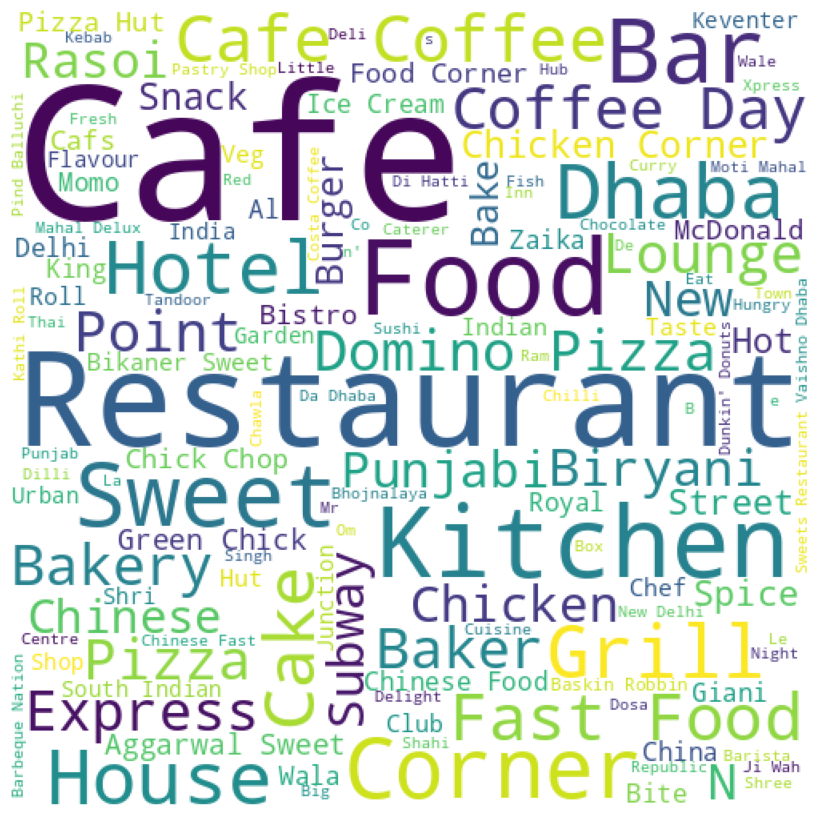

In [289]:
# make a word cloud on the resturant name coulmn
wordcloud = WordCloud(width = 500, height = 500, 
                background_color ='white', 
                stopwords = None, 
                min_font_size = 10).generate(' '.join(data['Restaurant Name']))     

plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.show()

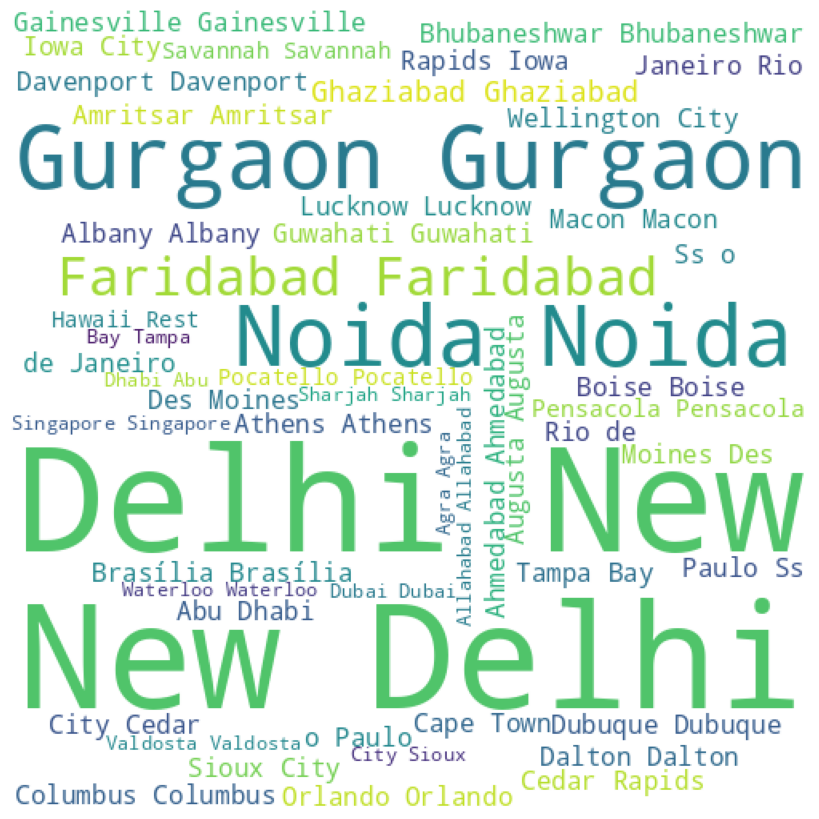

In [290]:
# make a word cloud on the resturant name coulmn
wordcloud = WordCloud(width = 500, height = 500, 
                background_color ='white', 
                stopwords = None, 
                min_font_size = 10).generate(' '.join(data['City']))     

plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.show()

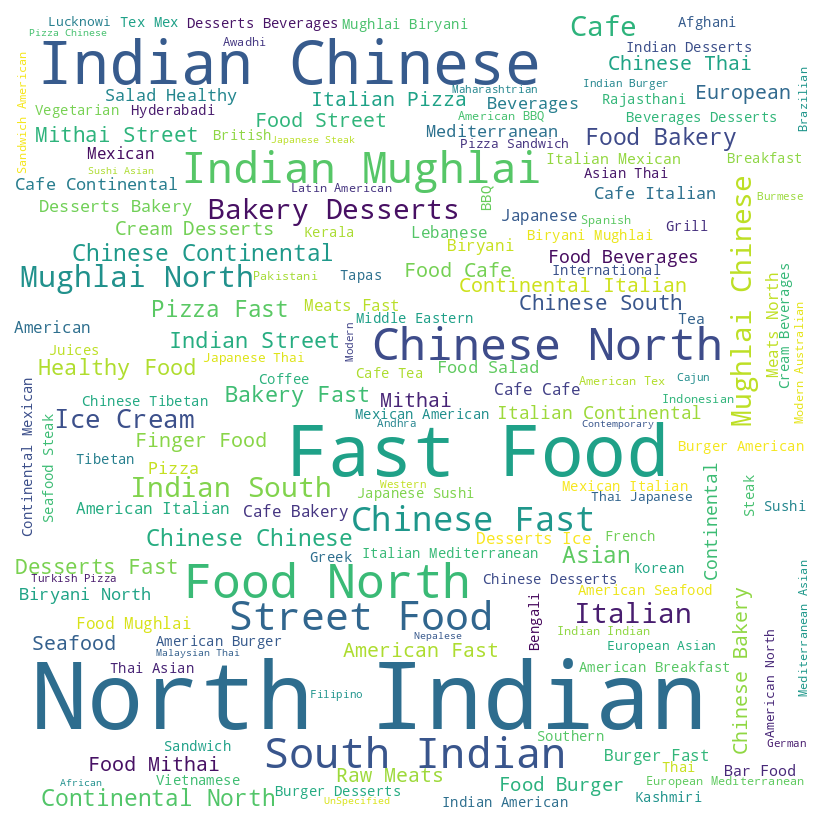

In [291]:
# make a word cloud on the resturant name coulmn
wordcloud = WordCloud(width = 800, height = 800, 
                background_color ='white', 
                stopwords = None, 
                min_font_size = 10).generate(' '.join(data['Cuisines']))     

plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.show()

In [292]:
data.head(5)

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,"French, Japanese, Desserts",...,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,314
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,Japanese,...,Botswana Pula(P),Yes,No,No,No,3,4.5,Dark Green,Excellent,591
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Ma...",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",...,Botswana Pula(P),Yes,No,No,No,4,4.4,Green,Very Good,270
3,6318506,Ooma,162,Mandaluyong City,"Third Floor, Mega Fashion Hall, SM Megamall, O...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.056475,14.585318,"Japanese, Sushi",...,Botswana Pula(P),No,No,No,No,4,4.9,Dark Green,Excellent,365
4,6314302,Sambo Kojin,162,Mandaluyong City,"Third Floor, Mega Atrium, SM Megamall, Ortigas...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.057508,14.584450,"Japanese, Korean",...,Botswana Pula(P),Yes,No,No,No,4,4.8,Dark Green,Excellent,229


/tmp/ipykernel_387/913818691.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_cities.values, y=top_cities.index, palette='coolwarm')


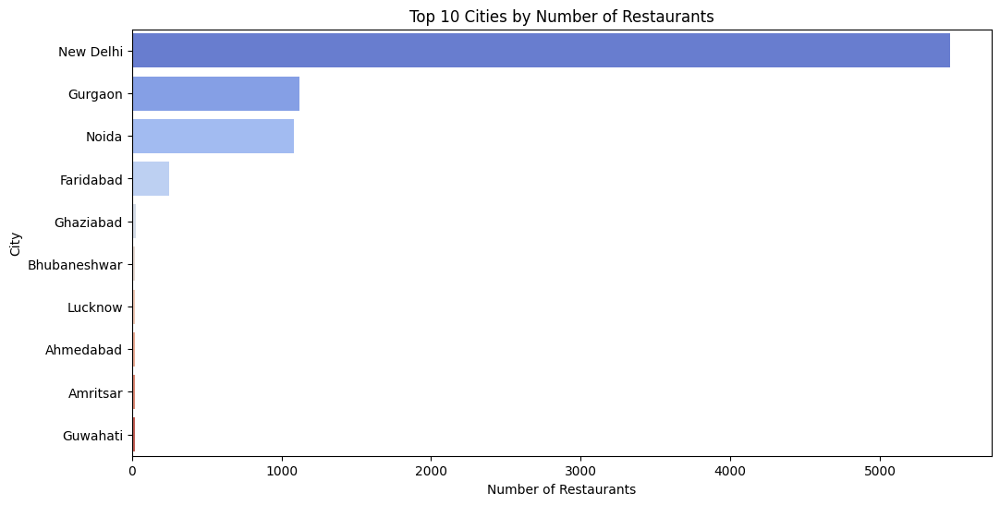

In [293]:
# Count the occurrences of each city
city_counts = data['City'].value_counts()

# Get the top 10 cities
top_cities = city_counts.head(10)

# Plot the top cities
plt.figure(figsize=(12, 6))
sns.barplot(x=top_cities.values, y=top_cities.index, palette='coolwarm')
plt.title('Top 10 Cities by Number of Restaurants')
plt.xlabel('Number of Restaurants')
plt.ylabel('City')
plt.show()

/tmp/ipykernel_387/177010043.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_cuisines.values, y=top_cuisines.index, palette='viridis')


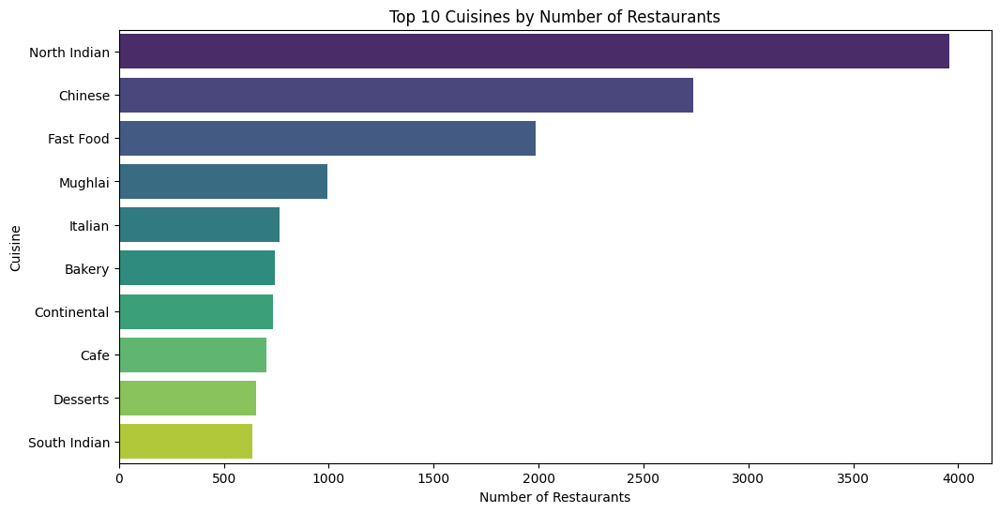

In [294]:
# Split the 'Cuisines' column (since it contains multiple cuisines separated by commas)
cuisine_counts = data['Cuisines'].str.split(', ', expand=True).stack().value_counts()

# Get the top 10 cuisines
top_cuisines = cuisine_counts.head(10)

# Plot the top cuisines
plt.figure(figsize=(12, 6))
sns.barplot(x=top_cuisines.values, y=top_cuisines.index, palette='viridis')
plt.title('Top 10 Cuisines by Number of Restaurants')
plt.xlabel('Number of Restaurants')
plt.ylabel('Cuisine')
plt.show()

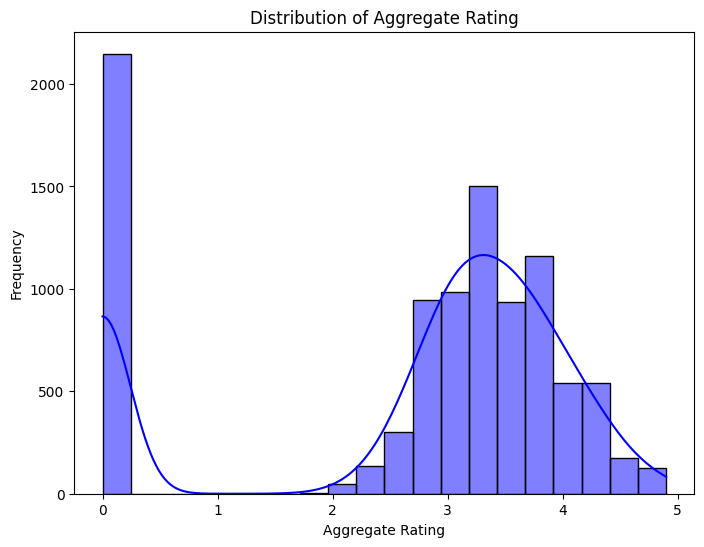

In [295]:
# Histogram for 'Aggregate rating'
plt.figure(figsize=(8, 6))
sns.histplot(data['Aggregate rating'], bins=20, kde=True, color='blue')
plt.title('Distribution of Aggregate Rating')
plt.xlabel('Aggregate Rating')
plt.ylabel('Frequency')
plt.show()

/tmp/ipykernel_387/1782714414.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=data, x='Rating text', palette='viridis')


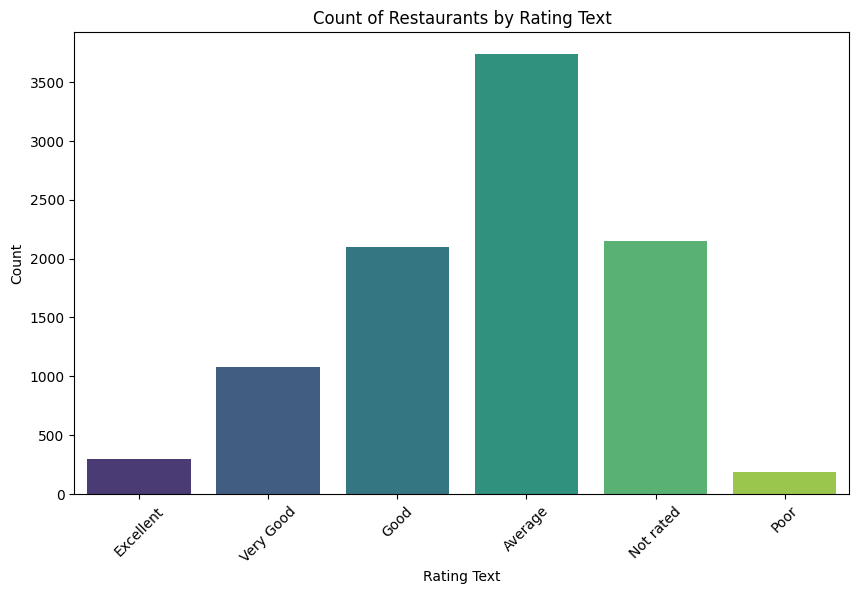

In [296]:
plt.figure(figsize=(10, 6))
sns.countplot(data=data, x='Rating text', palette='viridis')
plt.title('Count of Restaurants by Rating Text')
plt.xlabel('Rating Text')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

/tmp/ipykernel_387/765200247.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=currency_counts.index, y=currency_counts.values, palette='viridis')


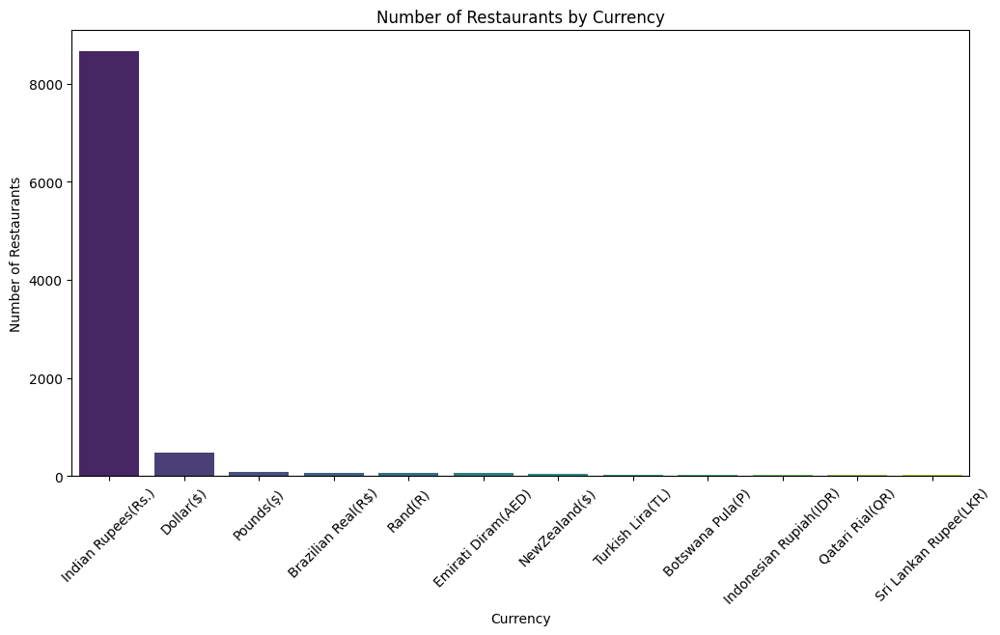

In [297]:
currency_counts = data['Currency'].value_counts()

# Plot the bar plot
plt.figure(figsize=(12, 6))
sns.barplot(x=currency_counts.index, y=currency_counts.values, palette='viridis')
plt.title('Number of Restaurants by Currency')
plt.xlabel('Currency')
plt.ylabel('Number of Restaurants')
plt.xticks(rotation=45)
plt.show()

/tmp/ipykernel_387/3570972698.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=data, x='Switch to order menu', palette='coolwarm')


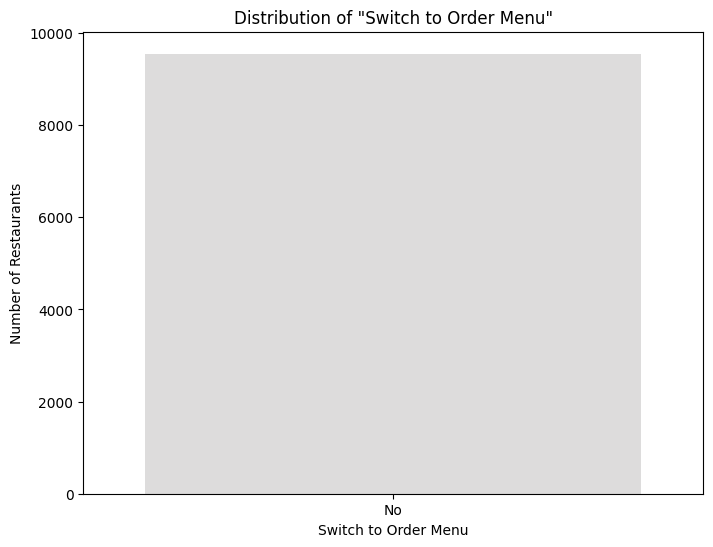

In [298]:
# Count plot for 'Switch to order menu'
plt.figure(figsize=(8, 6))
sns.countplot(data=data, x='Switch to order menu', palette='coolwarm')
plt.title('Distribution of "Switch to Order Menu"')
plt.xlabel('Switch to Order Menu')
plt.ylabel('Number of Restaurants')
plt.show()

For that Switch to order menu coulmn equals zero for all rows then it will be imedietly executed

In [299]:
# Drop the 'Switch to order menu' column
data.drop(columns=['Switch to order menu'], inplace=True)

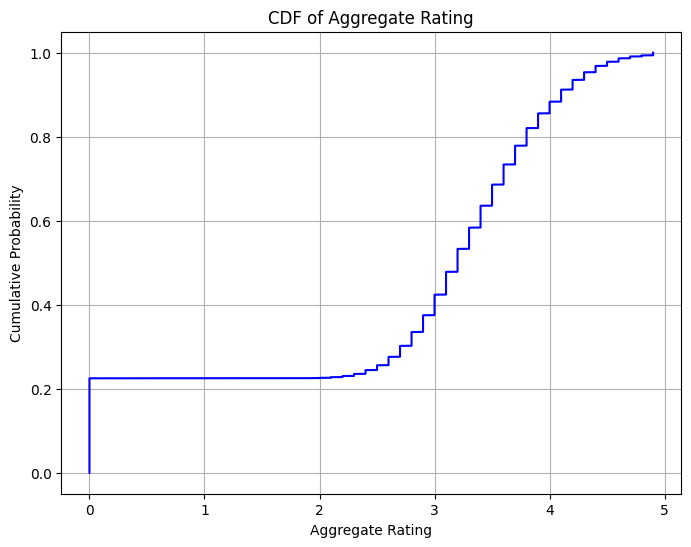

In [300]:
# Sort the data
sorted_rating = np.sort(data['Aggregate rating'])

# Calculate cumulative probability
yvals = np.arange(len(sorted_rating)) / float(len(sorted_rating) - 1)

# Plot CDF
plt.figure(figsize=(8, 6))
plt.plot(sorted_rating, yvals, color='blue')
plt.title('CDF of Aggregate Rating')
plt.xlabel('Aggregate Rating')
plt.ylabel('Cumulative Probability')
plt.grid()
plt.show()

/tmp/ipykernel_387/2982642017.py:13: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(city_counts.index, rotation=90)


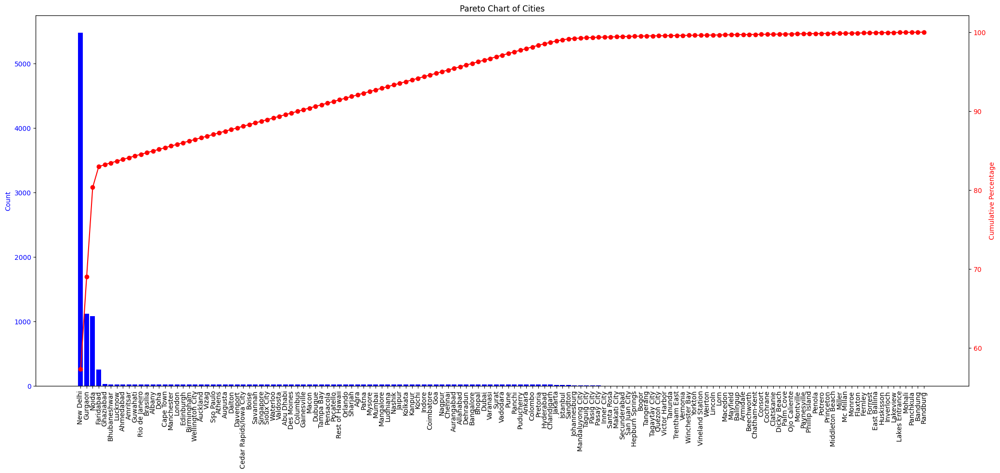

In [301]:
# Calculate value counts for 'City'
city_counts = data['City'].value_counts()

# Calculate cumulative percentage
city_counts = city_counts.sort_values(ascending=False)
cumulative_percentage = city_counts.cumsum() / city_counts.sum() * 100

# Plot Pareto chart
fig, ax1 = plt.subplots(figsize=(25, 10))
ax1.bar(city_counts.index, city_counts, color='blue')
ax1.set_ylabel('Count', color='blue')
ax1.tick_params(axis='y', labelcolor='blue')
ax1.set_xticklabels(city_counts.index, rotation=90)

# Add cumulative percentage line
ax2 = ax1.twinx()
ax2.plot(city_counts.index, cumulative_percentage, color='red', marker='o')
ax2.set_ylabel('Cumulative Percentage', color='red')
ax2.tick_params(axis='y', labelcolor='red')

plt.title('Pareto Chart of Cities')
plt.show()

# Pareto Chart of Cities 📊🌆

This **Pareto Chart** highlights the distribution of restaurants across cities, combining a bar chart (restaurant counts) with a cumulative percentage line to identify key contributors.

---

## Key Insights 🔍
1. **Top Cities**: A few cities dominate the dataset, shown by the steep rise in the cumulative percentage line.
2. **Opportunities**: The flatter line towards the right highlights cities with fewer restaurants, presenting potential for growth.
3. **Strategic Focus**: Businesses can prioritize dominant cities for impact or explore opportunities in underrepresented areas.

---

## Conclusion 🎯
The chart pinpoints **influential cities** for strategic planning, helping businesses optimize their efforts. 📈

/tmp/ipykernel_387/2154062772.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.stripplot(data=data, x='Price range', y='Aggregate rating', palette='coolwarm')


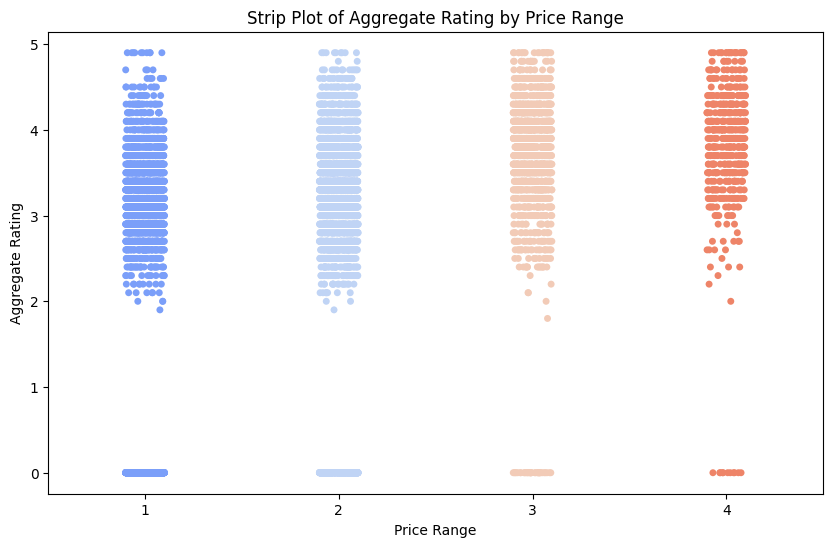

In [302]:
plt.figure(figsize=(10, 6))
sns.stripplot(data=data, x='Price range', y='Aggregate rating', palette='coolwarm')
plt.title('Strip Plot of Aggregate Rating by Price Range')
plt.xlabel('Price Range')
plt.ylabel('Aggregate Rating')
plt.show()

/tmp/ipykernel_387/1947615941.py:14: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ax.plot(angles, list(rating_counts) + [rating_counts[0]], linewidth=2, linestyle='solid')
/tmp/ipykernel_387/1947615941.py:15: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  ax.fill(angles, list(rating_counts) + [rating_counts[0]], 'blue', alpha=0.1)


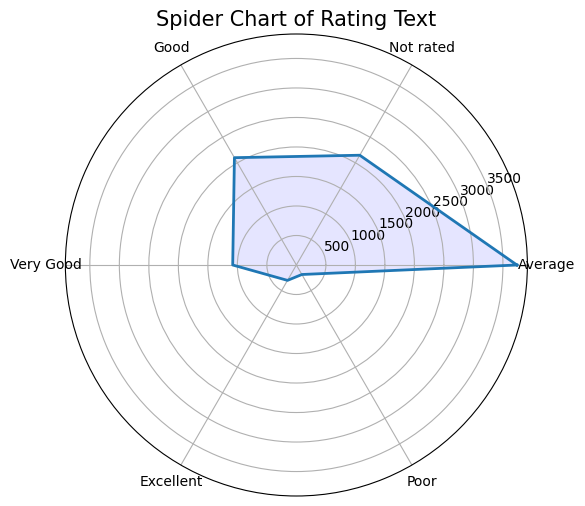

In [303]:
from math import pi

# Calculate value counts for 'Rating text'
rating_counts = data['Rating text'].value_counts()

# Create radar chart
categories = rating_counts.index
N = len(categories)
angles = [n / float(N) * 2 * pi for n in range(N)]
angles += angles[:1]  # Close the circle

# Plot
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw={'polar': True})
ax.plot(angles, list(rating_counts) + [rating_counts[0]], linewidth=2, linestyle='solid')
ax.fill(angles, list(rating_counts) + [rating_counts[0]], 'blue', alpha=0.1)

# Add labels
ax.set_xticks(angles[:-1])
ax.set_xticklabels(categories)
plt.title('Spider Chart of Rating Text', size=15)
plt.show()

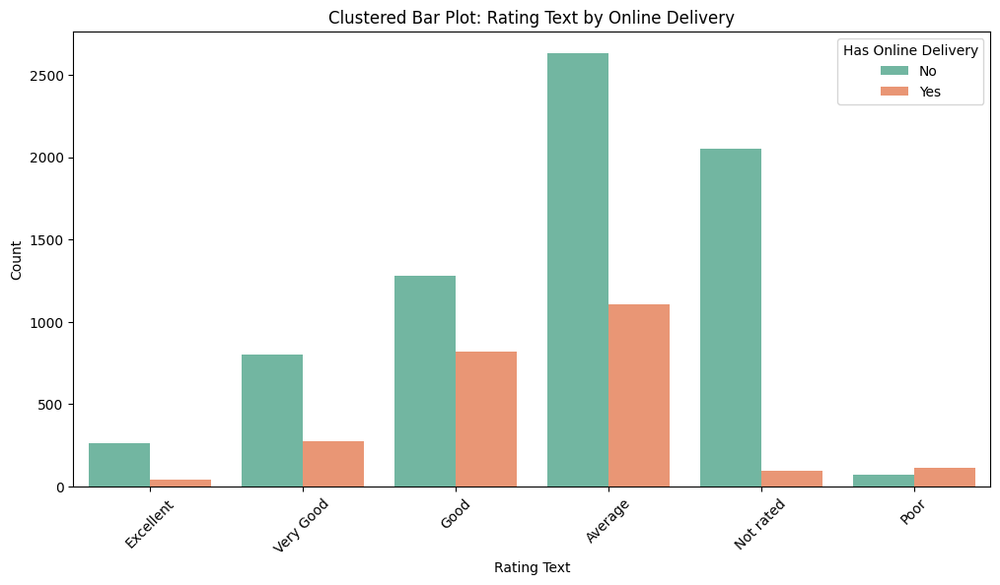

In [304]:
plt.figure(figsize=(12, 6))
sns.countplot(data=data, x='Rating text', hue='Has Online delivery', palette='Set2')
plt.title('Clustered Bar Plot: Rating Text by Online Delivery')
plt.xlabel('Rating Text')
plt.ylabel('Count')
plt.legend(title='Has Online Delivery')
plt.xticks(rotation=45)
plt.show()

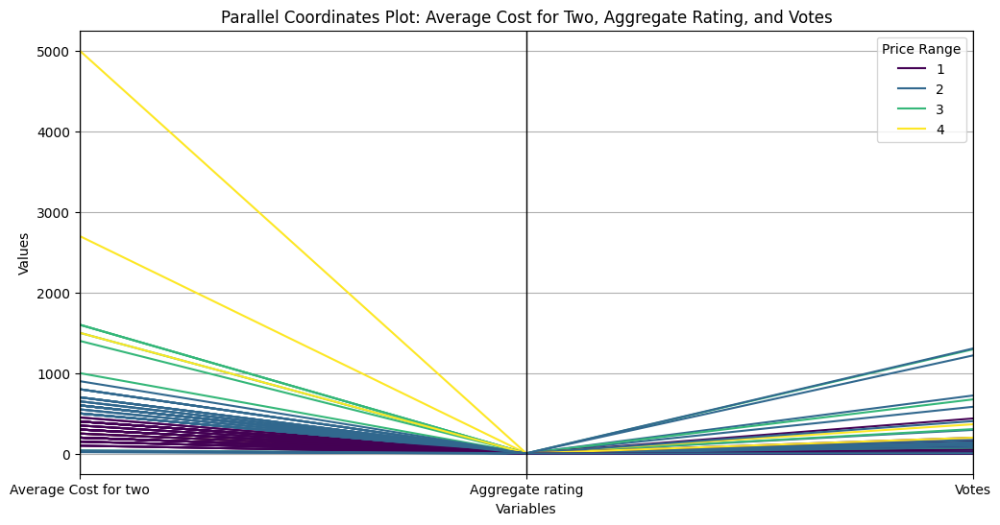

In [305]:
from pandas.plotting import parallel_coordinates

# Select a subset of data for better visualization
subset = data.sample(n=100, random_state=42)  # Randomly sample 100 rows

# Plot parallel coordinates
plt.figure(figsize=(12, 6))
parallel_coordinates(subset[['Average Cost for two', 'Aggregate rating', 'Votes', 'Price range']], 'Price range', colormap='viridis')
plt.title('Parallel Coordinates Plot: Average Cost for Two, Aggregate Rating, and Votes')
plt.xlabel('Variables')
plt.ylabel('Values')
plt.legend(title='Price Range')
plt.show()

# Parallel Coordinates Plot: Cost, Rating, and Votes 📊📈

This **Parallel Coordinates Plot** visualizes the relationship between **Average Cost for Two**, **Aggregate Rating**, **Votes**, and **Price Range**, highlighting key patterns and correlations.

---

## Insights 🔍
1. **Price Range Trends**:
   - Higher **Price Ranges** (3-4) often link to higher costs and ratings, while lower ranges (1-2) show more variability.
2. **Votes and Ratings**:
   - More votes align with consistent ratings, while fewer votes suggest variability or newer establishments.
3. **Cost vs. Rating**:
   - Higher costs often correspond to better ratings, reflecting customer perception of quality.

---

## Conclusion 🎯
This plot reveals how pricing, ratings, and customer feedback interact, helping businesses refine strategies for pricing and customer satisfaction. 🍽️📊

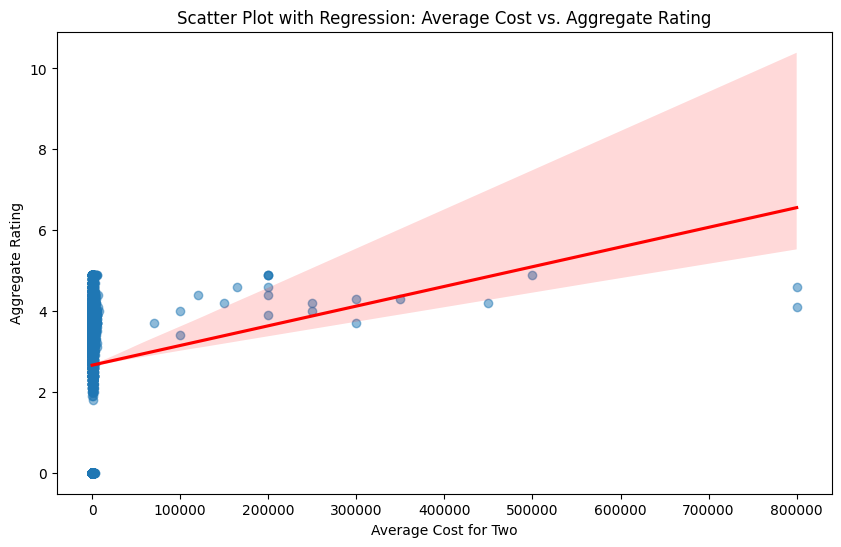

In [306]:
plt.figure(figsize=(10, 6))
sns.regplot(data=data, x='Average Cost for two', y='Aggregate rating', scatter_kws={'alpha': 0.5}, line_kws={'color': 'red'})
plt.title('Scatter Plot with Regression: Average Cost vs. Aggregate Rating')
plt.xlabel('Average Cost for Two')
plt.ylabel('Aggregate Rating')
plt.show()

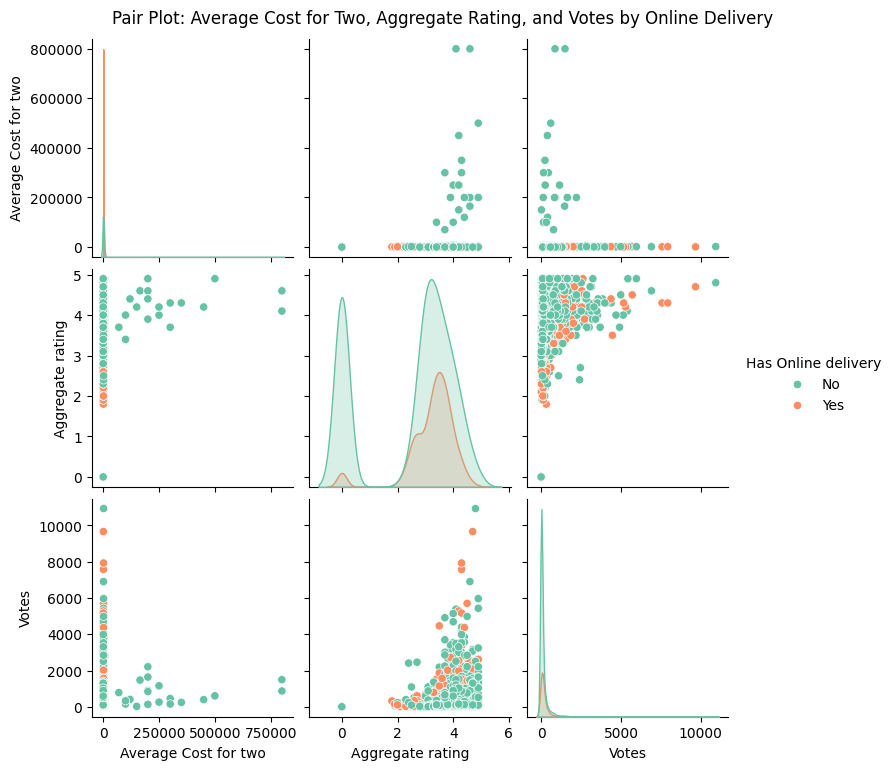

In [307]:
sns.pairplot(data, vars=['Average Cost for two', 'Aggregate rating', 'Votes'], hue='Has Online delivery', palette='Set2', diag_kind='kde')
plt.suptitle('Pair Plot: Average Cost for Two, Aggregate Rating, and Votes by Online Delivery', y=1.02)
plt.show()

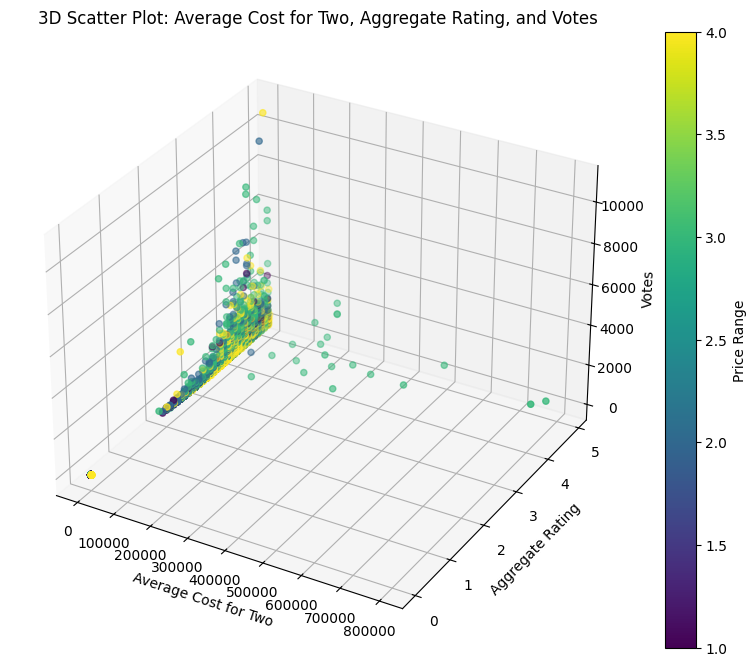

In [308]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(data['Average Cost for two'], data['Aggregate rating'], data['Votes'], c=data['Price range'], cmap='viridis', marker='o')
ax.set_xlabel('Average Cost for Two')
ax.set_ylabel('Aggregate Rating')
ax.set_zlabel('Votes')
plt.colorbar(scatter, label='Price Range')
plt.title('3D Scatter Plot: Average Cost for Two, Aggregate Rating, and Votes')
plt.show()

/tmp/ipykernel_387/477615396.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=data, x='Currency', y='Aggregate rating', palette='Set2')


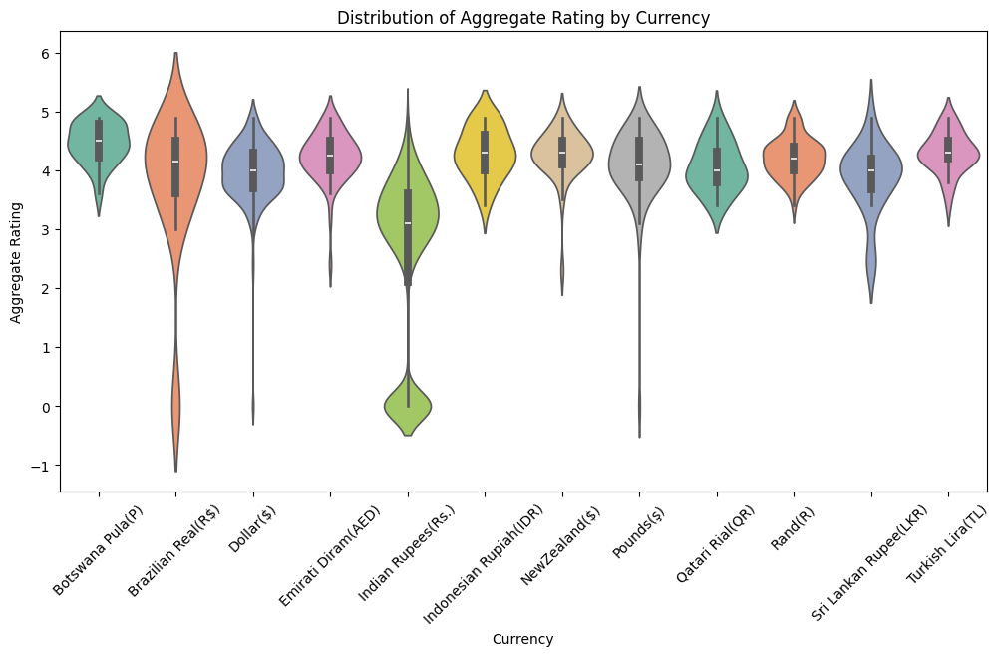

In [309]:
plt.figure(figsize=(12, 6))
sns.violinplot(data=data, x='Currency', y='Aggregate rating', palette='Set2')
plt.title('Distribution of Aggregate Rating by Currency')
plt.xlabel('Currency')
plt.ylabel('Aggregate Rating')
plt.xticks(rotation=45)
plt.show()

# Distribution of Aggregate Rating by Currency 📊💱

This chart examines how **aggregate ratings** vary across different **currencies**, revealing regional and economic trends in customer satisfaction.

---

## Key Insights 🌟
1. **Currency Differences**:
   - Ratings differ by currency, reflecting regional customer expectations.
   - Higher-rated currencies (e.g., USD, EUR) may link to regions with higher economic standards.

2. **Trends Over Time**:
   - Spanning **2018/01 to 2018/450**, the data highlights periodic rating patterns, including seasonal peaks or dips.

3. **Cultural Impact**:
   - Regional culinary preferences influence rating distributions, showcasing cultural effects on satisfaction.

---

## Conclusion 🎯
This analysis uncovers currency-based trends in ratings, helping businesses adapt to regional markets and customer expectations. 🌍📈

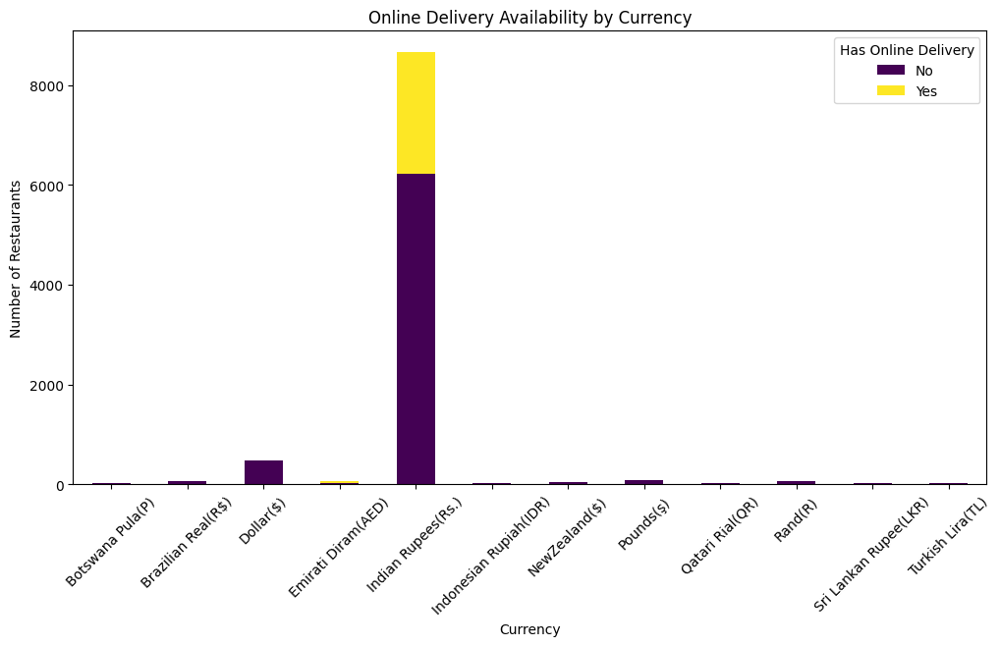

In [310]:
# Create a cross-tabulation of Currency and Has Online delivery
online_delivery_by_currency = pd.crosstab(data['Currency'], data['Has Online delivery'])

# Plot the stacked bar plot
online_delivery_by_currency.plot(kind='bar', stacked=True, figsize=(12, 6), colormap='viridis')
plt.title('Online Delivery Availability by Currency')
plt.xlabel('Currency')
plt.ylabel('Number of Restaurants')
plt.xticks(rotation=45)
plt.legend(title='Has Online Delivery')
plt.show()

# Task 4: Location-based Analysis
## Overview
In this task, we will perform **geospatial analysis** to visualize the locations of restaurants on a map using latitude and longitude information. We will also analyze the distribution of restaurants across different cities or countries and determine if there is any correlation between the restaurant's location and its rating.


/tmp/ipykernel_387/2131748118.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=city_counts.values, y=city_counts.index, palette='viridis')


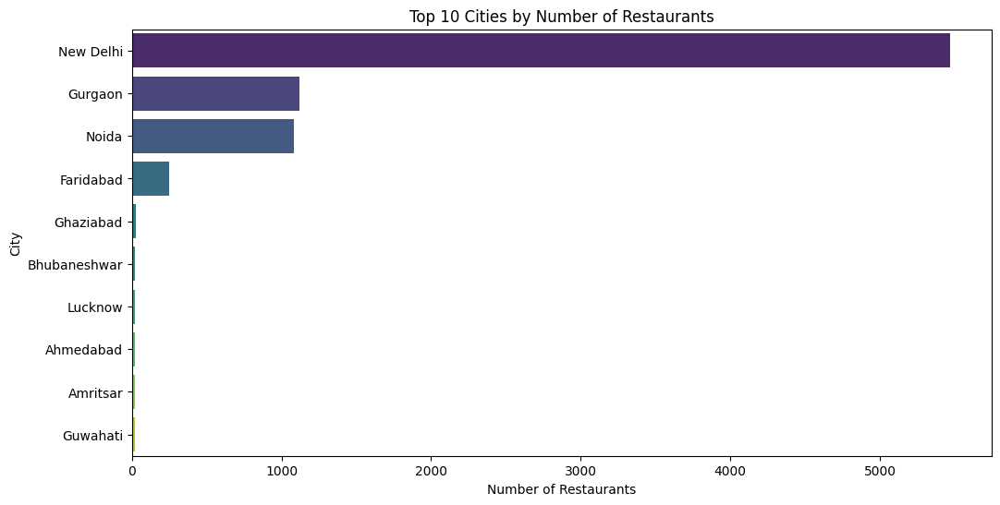

In [311]:
import seaborn as sns
import matplotlib.pyplot as plt

# Count the number of restaurants in each city
city_counts = data['City'].value_counts().head(10)  # Top 10 cities

# Plot the distribution
plt.figure(figsize=(12, 6))
sns.barplot(x=city_counts.values, y=city_counts.index, palette='viridis')
plt.title('Top 10 Cities by Number of Restaurants')
plt.xlabel('Number of Restaurants')
plt.ylabel('City')
plt.show()

In [312]:
import folium
from folium.plugins import MarkerCluster

# Create a base map centered at the mean latitude and longitude
map_center = [data['Latitude'].mean(), data['Longitude'].mean()]
restaurant_map = folium.Map(location=[0,0], zoom_start=2)

# Add restaurant locations to the map using MarkerCluster
marker_cluster = MarkerCluster().add_to(restaurant_map)

# Loop through the dataset and add markers for each restaurant
for index, row in data.iterrows():
    folium.Marker(
        location=[row['Latitude'], row['Longitude']],  # Latitude and Longitude
        popup=f"""
            <b>Restaurant:</b> {row['Restaurant Name']}<br>
            <b>Rating:</b> {row['Aggregate rating']}<br>
            <b>Cuisines:</b> {row['Cuisines']}<br>
            <b>Address:</b> {row['Address']}
        """,  # Popup with restaurant details
        tooltip=row['Restaurant Name'],  # Tooltip with restaurant name
        icon=folium.Icon(color='blue', icon='cutlery')  # Custom icon
    ).add_to(marker_cluster)

# Save the map to an HTML file
#restaurant_map.save('restaurant_map.html')

# Display the map
restaurant_map

# Interactive Restaurant Map 🌍📍

This **interactive map** uses **Folium** and **MarkerCluster** to showcase restaurant locations along with their details.

---

## Key Features 🛠️
- **Map Center**: Focused on the mean latitude and longitude of the dataset.
- **MarkerCluster**: Groups nearby restaurants for easier navigation.
- **Interactive Markers**: Clickable markers display:
  - **Name**, **Rating**, **Cuisines**, and **Address**.
- **Tooltips**: Hover to see the restaurant name.

---

## How to Use 🚀
- **Zoom & Pan**: Explore different areas.
- **Click Markers**: View restaurant details.
- **Expand Clusters**: Uncover individual locations.

---

## Conclusion 🎯
This map offers an efficient way to explore restaurant locations and details, catering to both food enthusiasts and analysts. 🍴📍

In [313]:
import folium
import pandas as pd
from folium.plugins import MarkerCluster

# First, group the data by city and calculate average ratings
city_data = data.groupby('City').agg({
    'Aggregate rating': 'mean',
    'Latitude': 'mean',
    'Longitude': 'mean',
    'Restaurant Name': 'count'  # This will give us the number of restaurants per city
}).reset_index()

# Create a base map centered at the mean latitude and longitude
map_center = [city_data['Latitude'].mean(), city_data['Longitude'].mean()]
city_map = folium.Map(location=[0,0], zoom_start=2)

# Add city locations to the map using MarkerCluster
marker_cluster = MarkerCluster().add_to(city_map)

# Function to determine marker color based on rating
def get_color(rating):
    if rating >= 4.5:
        return 'red'
    elif rating >= 4.0:
        return 'orange'
    elif rating >= 3.5:
        return 'green'
    else:
        return 'blue'

# Loop through the cities and add markers
for index, row in city_data.iterrows():
    # Create popup content with HTML formatting
    popup_content = f"""
        <b>City:</b> {row['City']}<br>
        <b>Average Rating:</b> {row['Aggregate rating']:.2f}/5.0<br>
        <b>Number of Restaurants:</b> {int(row['Restaurant Name'])}
    """
    
    # Create marker for each city
    folium.Marker(
        location=[row['Latitude'], row['Longitude']],
        popup=popup_content,
        tooltip=f"{row['City']} - Avg Rating: {row['Aggregate rating']:.2f}",
        icon=folium.Icon(
            color=get_color(row['Aggregate rating']),
            icon='info-sign'
        )
    ).add_to(marker_cluster)

# Add a legend
legend_html = '''
<div style="position: fixed; 
            bottom: 50px; right: 50px; 
            border:2px solid grey; z-index:9999; font-size:14px;
            background-color: white;
            padding: 10px;
            border-radius: 5px;">
    <p><b>Rating Legend:</b></p>
    <p><i class="fa fa-map-marker fa-2x" style="color:red"></i> 4.5+</p>
    <p><i class="fa fa-map-marker fa-2x" style="color:orange"></i> 4.0-4.49</p>
    <p><i class="fa fa-map-marker fa-2x" style="color:green"></i> 3.5-3.99</p>
    <p><i class="fa fa-map-marker fa-2x" style="color:blue"></i> < 3.5</p>
</div>
'''
city_map.get_root().html.add_child(folium.Element(legend_html))

# Save the map to an HTML file
city_map.save('city_ratings_map.html')

# Display the map
city_map

# 🌎 Global Restaurant Ratings Distribution

This world map visualization reveals some interesting patterns in restaurant ratings across different regions:

## 🌟 High-Rating Clusters
- North America shows strong ratings with clusters of **26** and **12** restaurants respectively
- Middle East region displays a notable concentration with **47** restaurants
- Asia-Pacific region demonstrates solid performance with **23** and **14** restaurants

## 🌿 Moderate-Rating Areas
- Northern Europe shows modest numbers with **4** restaurants
- Eastern Europe/Central Asia region has **2** establishments
- South America contains **3** rated restaurants
- Africa (Madagascar region) shows **6** establishments
- Pacific region displays **2** locations

## 📊 Key Rating Categories:
- 🔴 4.5+ : Outstanding restaurants
- 🟠 4.0-4.49 : Very good establishments
- 🟢 3.5-3.99 : Good quality eateries
- 🔵 < 3.5 : Average/Below average venues

## 🔍 Notable Observations
- Highest concentration of restaurants appears in urbanized regions
- Coastal areas tend to have higher numbers of rated establishments
- There's a noticeable gap in coverage in certain regions like Central Africa and Central Asia

The visualization effectively uses color-coding and clustering to represent both the quantity and quality of restaurants across different global regions. 🗺️

In [314]:
import pandas as pd
import numpy as np

# Calculate basic statistics by city
city_stats = data.groupby('City').agg({
    'Aggregate rating': ['count', 'mean', 'std', 'min', 'max'],
    'Price range': ['mean', 'min', 'max'],
    'Average Cost for two': ['mean', 'median']
}).round(2)

city_stats.columns = [
    'Number of Restaurants', 'Average Rating', 'Rating Std Dev', 
    'Lowest Rating', 'Highest Rating', 'Avg Price Range', 
    'Min Price Range', 'Max Price Range', 'Avg Cost for Two',
    'Median Cost for Two'
]

# Get top cuisines by city
def get_top_cuisines(group, n=3):
    # Split cuisine strings and flatten
    all_cuisines = [cuisine.strip() 
                   for cuisines in group['Cuisines'].str.split(',') 
                   for cuisine in cuisines]
    # Count and get top n
    return pd.Series(all_cuisines).value_counts().nlargest(n).to_dict()

cuisine_stats = data.groupby('City').apply(get_top_cuisines)

# Calculate percentage of restaurants by price range in each city
price_distribution = pd.crosstab(
    data['City'], 
    data['Price range'],
    normalize='index'
).round(3) * 100

# Generate summary report
print("=== Restaurant Statistics by City ===\n")
print(city_stats)

print("\n=== Top Cuisines by City ===\n")
for city, cuisines in cuisine_stats.items():
    print(f"\n{city}:")
    for cuisine, count in cuisines.items():
        print(f"- {cuisine}: {count} restaurants")

print("\n=== Price Range Distribution (%) ===\n")
print(price_distribution)

# Additional insights
print("\n=== Key Insights ===")
print(f"\nCities with highest average ratings:")
print(city_stats.nlargest(5, 'Average Rating')[['Average Rating', 'Number of Restaurants']])

print(f"\nCities with most restaurant variety:")
print(city_stats.nlargest(5, 'Number of Restaurants')[['Number of Restaurants', 'Average Rating']])

print(f"\nCities with highest average cost for two:")
print(city_stats.nlargest(5, 'Avg Cost for Two')[['Avg Cost for Two', 'Average Rating']])

=== Restaurant Statistics by City ===

                 Number of Restaurants  Average Rating  Rating Std Dev  \
City                                                                     
Abu Dhabi                           20            4.30            0.32   
Agra                                20            3.96            0.35   
Ahmedabad                           21            4.16            0.29   
Albany                              20            3.56            0.19   
Allahabad                           20            3.40            0.14   
...                                ...             ...             ...   
Weirton                              1            3.90             NaN   
Wellington City                     20            4.25            0.20   
Winchester Bay                       1            3.20             NaN   
Yorkton                              1            3.30             NaN   
İstanbul                            14            4.29            0.40   

/tmp/ipykernel_387/35904758.py:27: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  cuisine_stats = data.groupby('City').apply(get_top_cuisines)


In [315]:
data.shape

(9551, 20)

In [316]:
import pandas as pd
import numpy as np
from scipy import stats

def analyze_location_patterns(data):
    # 1. Density Analysis
    location_density = data.groupby(['Locality', 'City']).agg({
        'Restaurant Name': 'count',
        'Aggregate rating': 'mean',
        'Average Cost for two': 'mean'
    }).round(2)
    
    # 2. Geographic Clustering
    def calculate_restaurant_clusters(group):
        if len(group) < 2:
            return pd.Series({'cluster_density': 0, 'avg_distance': 0})
        
        # Calculate distances between restaurants
        distances = []
        for i in range(len(group)):
            for j in range(i+1, len(group)):
                lat1, lon1 = group.iloc[i][['Latitude', 'Longitude']]
                lat2, lon2 = group.iloc[j][['Latitude', 'Longitude']]
                distance = np.sqrt((lat2-lat1)**2 + (lon2-lon1)**2)
                distances.append(distance)
                
        return pd.Series({
            'cluster_density': len(group) / (max(distances) if distances else 1),
            'avg_distance': np.mean(distances) if distances else 0
        })
    
    cluster_analysis = data.groupby('Locality').apply(calculate_restaurant_clusters)
    
    # 3. Rating vs Location Analysis
    location_rating_corr = data.groupby('Locality').agg({
        'Aggregate rating': ['mean', 'std'],
        'Latitude': 'mean',
        'Longitude': 'mean'
    })
    
    # 4. Price Distribution by Area
    price_by_location = data.groupby('Locality').agg({
        'Average Cost for two': ['mean', 'median', 'std'],
        'Price range': 'mean'
    })
    
    # 5. Generate Insights Report
    print("=== Restaurant Location Analysis Report ===\n")
    
    print("1. High-Density Restaurant Areas:")
    print(location_density.nlargest(10, 'Restaurant Name'))
    
    print("\n2. Geographic Clustering Insights:")
    print(cluster_analysis.nlargest(10, 'cluster_density'))
    
    print("\n3. Location-Rating Correlations:")
    correlations = stats.pearsonr(
        data['Latitude'],
        data['Aggregate rating']
    )
    print(f"Latitude-Rating Correlation: {correlations[0]:.3f}")
    correlations = stats.pearsonr(
        data['Longitude'],
        data['Aggregate rating']
    )
    print(f"Longitude-Rating Correlation: {correlations[0]:.3f}")
    
    print("\n4. Price Distribution Patterns:")
    print(price_by_location.nlargest(10, ('Average Cost for two', 'mean')))
    
    # 6. Special Insights
    print("\n5. Special Location-Based Insights:")
    
    # Find areas with high ratings but low prices
    value_score = (data.groupby('Locality').agg({
        'Aggregate rating': 'mean',
        'Average Cost for two': 'mean'
    }))
    value_score['value_ratio'] = value_score['Aggregate rating'] / value_score['Average Cost for two']
    
    print("\nBest Value Locations (High Rating/Price Ratio):")
    print(value_score.nlargest(5, 'value_ratio'))
    
    # Find diverse cuisine areas
    cuisine_diversity = data.groupby('Locality')['Cuisines'].apply(
        lambda x: len(set(','.join(x).split(',')))
    )
    
    print("\nMost Cuisine-Diverse Locations:")
    print(cuisine_diversity.nlargest(5))
    
    return {
        'density': location_density,
        'clusters': cluster_analysis,
        'ratings': location_rating_corr,
        'prices': price_by_location,
        'value_score': value_score,
        'cuisine_diversity': cuisine_diversity
    }

# Run the analysis
results = analyze_location_patterns(data)

/tmp/ipykernel_387/3163442452.py:28: RuntimeWarning: divide by zero encountered in scalar divide
  'cluster_density': len(group) / (max(distances) if distances else 1),
/tmp/ipykernel_387/3163442452.py:28: RuntimeWarning: divide by zero encountered in scalar divide
  'cluster_density': len(group) / (max(distances) if distances else 1),
/tmp/ipykernel_387/3163442452.py:28: RuntimeWarning: divide by zero encountered in scalar divide
  'cluster_density': len(group) / (max(distances) if distances else 1),
/tmp/ipykernel_387/3163442452.py:28: RuntimeWarning: divide by zero encountered in scalar divide
  'cluster_density': len(group) / (max(distances) if distances else 1),
/tmp/ipykernel_387/3163442452.py:28: RuntimeWarning: divide by zero encountered in scalar divide
  'cluster_density': len(group) / (max(distances) if distances else 1),
/tmp/ipykernel_387/3163442452.py:28: RuntimeWarning: divide by zero encountered in scalar divide
  'cluster_density': len(group) / (max(distances) if dista

=== Restaurant Location Analysis Report ===

1. High-Density Restaurant Areas:
                               Restaurant Name  Aggregate rating  \
Locality            City                                           
Connaught Place     New Delhi              122              3.69   
Rajouri Garden      New Delhi               99              3.59   
Shahdara            New Delhi               87              1.41   
Defence Colony      New Delhi               86              3.21   
Pitampura           New Delhi               85              2.87   
Malviya Nagar       New Delhi               84              3.42   
Mayur Vihar Phase 1 New Delhi               84              2.03   
Rajinder Nagar      New Delhi               81              2.94   
Safdarjung          New Delhi               80              2.80   
Satyaniketan        New Delhi               79              3.48   

                               Average Cost for two  
Locality            City                          

/tmp/ipykernel_387/3163442452.py:32: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  cluster_analysis = data.groupby('Locality').apply(calculate_restaurant_clusters)


# 📊 Restaurant Location Analysis Insights

## 🏙️ High-Density Restaurant Areas (New Delhi)
- **Connaught Place** leads with 122 restaurants (Avg. rating: 3.69, Avg. cost: ₹1,175)
- **Rajouri Garden** follows with 99 restaurants (Avg. rating: 3.59, Avg. cost: ₹855)
- Most high-density areas are concentrated in New Delhi, showing the city's vibrant food scene

## 💰 Price Distribution Highlights
- **Most Expensive Location**: Hotel Shangri-La, Sudirman (Avg. cost: 800,000)
- **Premium Areas**: Grand Indonesia Mall and Penjaringan (Avg. cost: 500,000)
- **Mid-Range Areas**: Thamrin and Alam Sutera Town Center (Avg. cost: 300,000-350,000)

## 🌟 Value for Money Findings
Best value locations (high rating-to-price ratio):
1. Miller (Rating: 3.4)
2. Parade (Rating: 3.9)
3. Lava Hot Springs (Rating: 3.6)
4. Lakes Entrance (Rating: 3.8)
5. Inverloch (Rating: 3.7)

## 🍽️ Cuisine Diversity Champions
Most diverse culinary locations:
1. Connaught Place (65 cuisines)
2. Rajouri Garden (54 cuisines)
3. Malviya Nagar (52 cuisines)
4. Defence Colony (48 cuisines)
5. Cyber Hub, DLF Cyber City (47 cuisines)

## 📍 Geographic Correlations
- Minimal correlation between latitude and ratings (0.001)
- Slight negative correlation between longitude and ratings (-0.117)
- This suggests location coordinates alone don't significantly influence restaurant ratings

## 💡 Key Takeaways
1. New Delhi dominates in terms of restaurant density and cuisine diversity
2. Premium locations tend to cluster around hotels and shopping malls
3. Some areas offer exceptional value with high ratings despite lower prices
4. Geographic location has minimal impact on restaurant ratings
5. High-density areas tend to have moderate to good average ratings (2.8-3.7)

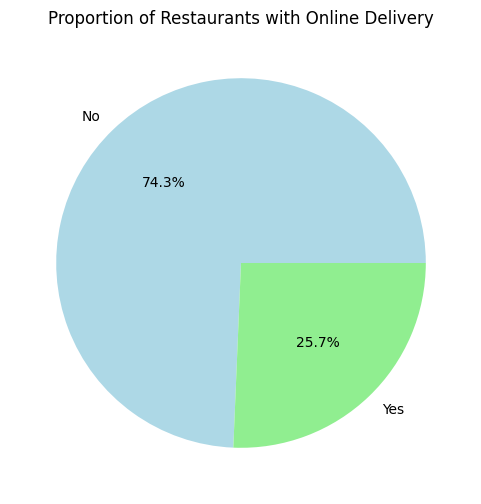

In [317]:
# Pie chart for 'Has Online delivery'
plt.figure(figsize=(6, 6))
data['Has Online delivery'].value_counts().plot(kind='pie', autopct='%1.1f%%', colors=['lightblue', 'lightgreen'])
plt.title('Proportion of Restaurants with Online Delivery')
plt.ylabel('')
plt.show()

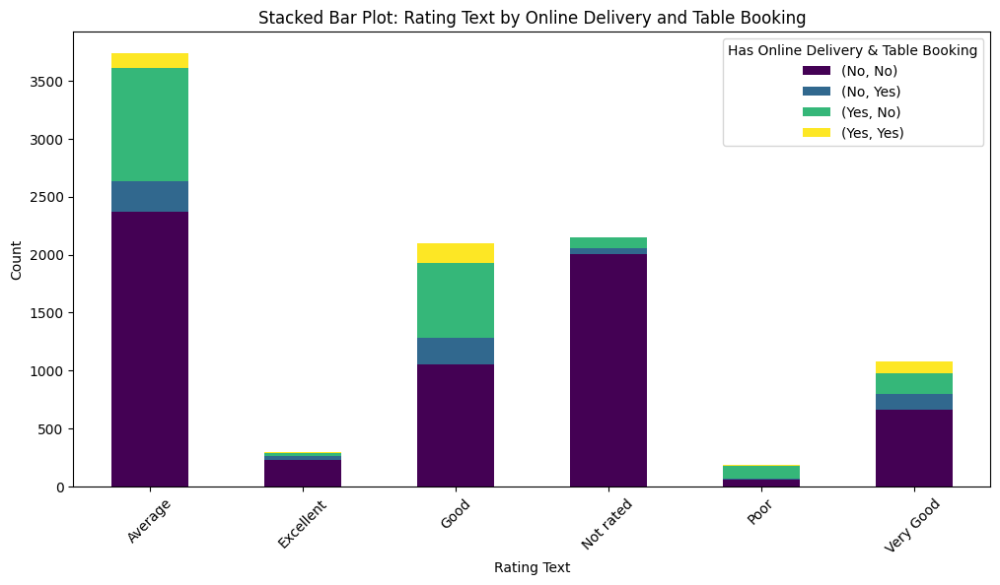

In [318]:
# Create a cross-tabulation
cross_tab = pd.crosstab(data['Rating text'], [data['Has Online delivery'], data['Has Table booking']])

# Plot stacked bar plot
cross_tab.plot(kind='bar', stacked=True, figsize=(12, 6), colormap='viridis')
plt.title('Stacked Bar Plot: Rating Text by Online Delivery and Table Booking')
plt.xlabel('Rating Text')
plt.ylabel('Count')
plt.legend(title='Has Online Delivery & Table Booking')
plt.xticks(rotation=45)
plt.show()

# Stacked Bar Plot: Rating Text by Online Delivery and Table Booking 📊🍽️

This **stacked bar plot** visualizes the distribution of **Rating Text** based on the availability of **Online Delivery** and **Table Booking**. It provides insights into how these services impact customer ratings.

---

## Key Observations 🔍
- **X-Axis**: Represents different combinations of **Online Delivery** and **Table Booking**:
  - (No, No): Neither service is available.
  - (No, Yes): Table booking available, but no online delivery.
  - (Yes, No): Online delivery available, but no table booking.
  - (Yes, Yes): Both services are available.
- **Y-Axis**: Shows the **count** of ratings for each combination.
- **Stacked Bars**: Each bar is divided by **Rating Text**, indicating the distribution of ratings (e.g., Excellent, Good, Average, Poor).

---

## Insights 🌟
1. **Combination Impact**: 
   - The availability of both services **(Yes, Yes)** likely has the highest count of positive ratings (e.g., Excellent or Good).
   - The absence of both services **(No, No)** may show a higher proportion of lower ratings (e.g., Average or Poor).
   
2. **Service Preference**:
   - Customers may prefer establishments offering at least one of the services (Online Delivery or Table Booking).

---

## Conclusion 🎯
This visualization highlights the **importance of offering Online Delivery and Table Booking** for improving customer ratings. Businesses should consider these services to enhance customer satisfaction and attract more positive reviews. 📈🍴

Average Ratings by Table Booking Availability:
Has Table booking
No     2.56
Yes    3.44
Name: Aggregate rating, dtype: float64


/tmp/ipykernel_387/3591444830.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=table_booking_ratings.index, y=table_booking_ratings.values, palette='coolwarm')


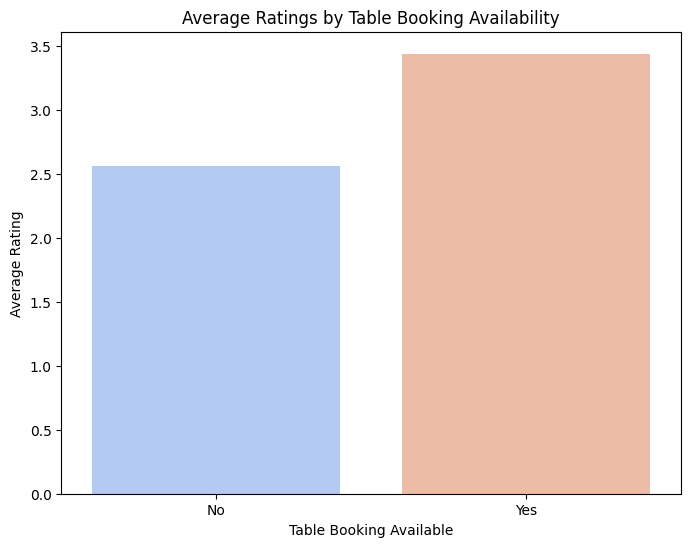

In [319]:
table_booking_ratings = data.groupby('Has Table booking')['Aggregate rating'].mean().round(2)

# Display results
print("Average Ratings by Table Booking Availability:")
print(table_booking_ratings)

# Visualize the comparison
plt.figure(figsize=(8, 6))
sns.barplot(x=table_booking_ratings.index, y=table_booking_ratings.values, palette='coolwarm')
plt.title('Average Ratings by Table Booking Availability')
plt.xlabel('Table Booking Available')
plt.ylabel('Average Rating')
plt.show()

Percentage of Restaurants Offering Online Delivery by Price Range:
Has Online delivery     No    Yes
Price range                      
1                    84.23  15.77
2                    58.69  41.31
3                    70.81  29.19
4                    90.96   9.04


<Figure size 1000x600 with 0 Axes>

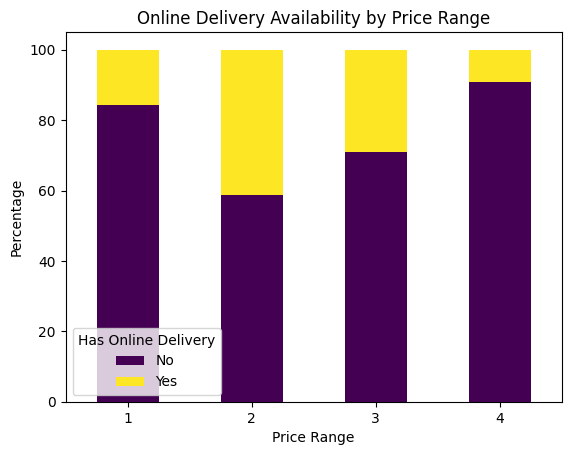

In [320]:
online_delivery_by_price = data.groupby('Price range')['Has Online delivery'].value_counts(normalize=True).unstack() * 100

# Display results
print("Percentage of Restaurants Offering Online Delivery by Price Range:")
print(online_delivery_by_price.round(2))

# Visualize the results
plt.figure(figsize=(10, 6))
online_delivery_by_price.plot(kind='bar', stacked=True, colormap='viridis')
plt.title('Online Delivery Availability by Price Range')
plt.xlabel('Price Range')
plt.ylabel('Percentage')
plt.legend(title='Has Online Delivery')
plt.xticks(rotation=0)
plt.show()

# Task 2: Price Range Analysis

## Overview
In this task, we will analyze the **price range** of restaurants to:
1. Determine the most common price range among all restaurants.
2. Calculate the average rating for each price range.
3. Identify the color that represents the highest average rating among different price ranges.

Color Representing the Highest Average Rating by Price Range:
Price range
1    Dark Green
2    Dark Green
3    Dark Green
4    Dark Green
dtype: object


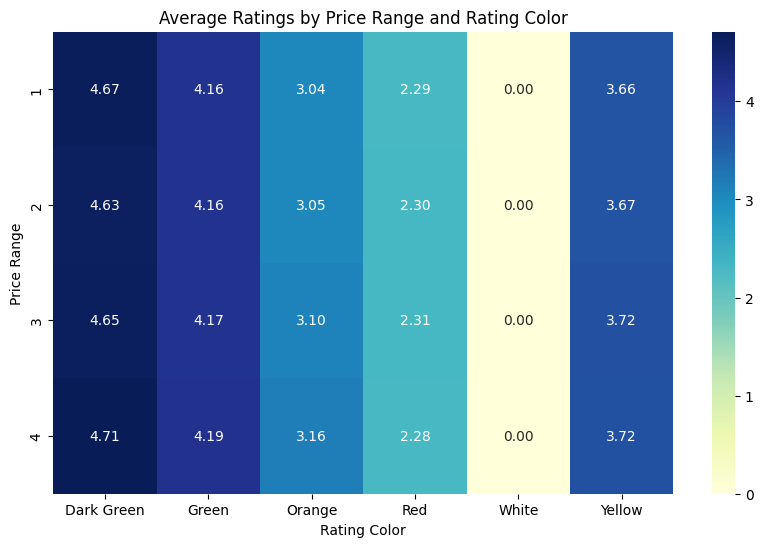

In [321]:
# Group by 'Price range' and 'Rating color' and calculate the mean rating
rating_color_by_price = data.groupby(['Price range', 'Rating color'])['Aggregate rating'].mean().unstack()

# Find the color with the highest average rating for each price range
highest_rating_color_by_price = rating_color_by_price.idxmax(axis=1)

# Display the results
print("Color Representing the Highest Average Rating by Price Range:")
print(highest_rating_color_by_price)

# Visualize the results
plt.figure(figsize=(10, 6))
sns.heatmap(rating_color_by_price, annot=True, cmap='YlGnBu', fmt='.2f')
plt.title('Average Ratings by Price Range and Rating Color')
plt.xlabel('Rating Color')
plt.ylabel('Price Range')
plt.show()

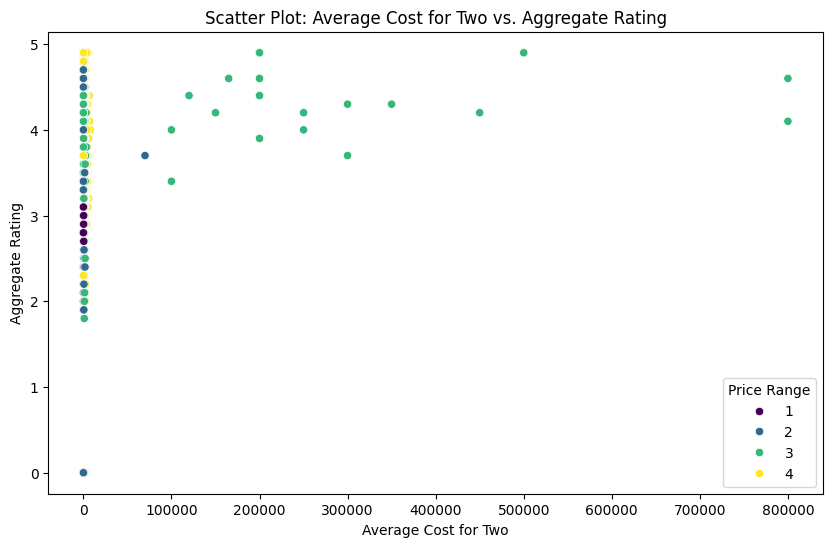

In [323]:
plt.figure(figsize=(10, 6))
sns.scatterplot(data=data, x='Average Cost for two', y='Aggregate rating', hue='Price range', palette='viridis')
plt.title('Scatter Plot: Average Cost for Two vs. Aggregate Rating')
plt.xlabel('Average Cost for Two')
plt.ylabel('Aggregate Rating')
plt.legend(title='Price Range')
plt.show()

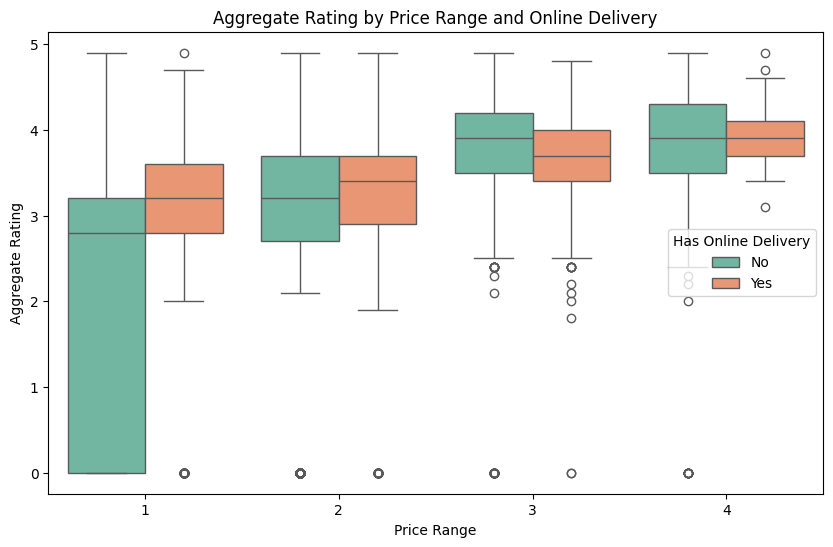

In [324]:
plt.figure(figsize=(10, 6))
sns.boxplot(data=data, x='Price range', y='Aggregate rating', hue='Has Online delivery', palette='Set2')
plt.title('Aggregate Rating by Price Range and Online Delivery')
plt.xlabel('Price Range')
plt.ylabel('Aggregate Rating')
plt.legend(title='Has Online Delivery')
plt.show()

# Task 1: Predict Restaurant Ratings

## Objective:
Build a machine learning model to predict the
aggregate rating of a restaurant based on other features.

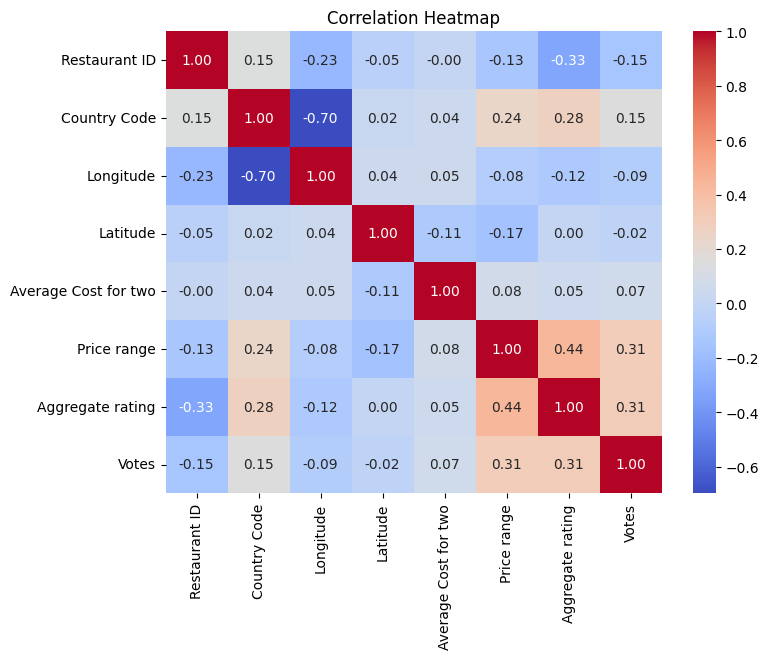

In [325]:
# Calculate correlation matrix
corr_matrix = data[numirical_columns].corr()

# Plot heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Heatmap')
plt.show()

In [326]:
data['Has Table booking'] = data['Has Table booking'].apply(lambda x: 1 if x == 'Yes' else 0)

data['Has Online delivery'] = data['Has Online delivery'].apply(lambda x: 1 if x == 'Yes' else 0)

data['Is delivering now'] = data['Is delivering now'].apply(lambda x: 1 if x == 'Yes' else 0)

In [327]:
data.columns

Index(['Restaurant ID', 'Restaurant Name', 'Country Code', 'City', 'Address',
       'Locality', 'Locality Verbose', 'Longitude', 'Latitude', 'Cuisines',
       'Average Cost for two', 'Currency', 'Has Table booking',
       'Has Online delivery', 'Is delivering now', 'Price range',
       'Aggregate rating', 'Rating color', 'Rating text', 'Votes'],
      dtype='object')

In [328]:
data

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,Average Cost for two,Currency,Has Table booking,Has Online delivery,Is delivering now,Price range,Aggregate rating,Rating color,Rating text,Votes
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,"French, Japanese, Desserts",1100,Botswana Pula(P),1,0,0,3,4.8,Dark Green,Excellent,314
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,Japanese,1200,Botswana Pula(P),1,0,0,3,4.5,Dark Green,Excellent,591
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Ma...",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",4000,Botswana Pula(P),1,0,0,4,4.4,Green,Very Good,270
3,6318506,Ooma,162,Mandaluyong City,"Third Floor, Mega Fashion Hall, SM Megamall, O...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.056475,14.585318,"Japanese, Sushi",1500,Botswana Pula(P),0,0,0,4,4.9,Dark Green,Excellent,365
4,6314302,Sambo Kojin,162,Mandaluyong City,"Third Floor, Mega Atrium, SM Megamall, Ortigas...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.057508,14.584450,"Japanese, Korean",1500,Botswana Pula(P),1,0,0,4,4.8,Dark Green,Excellent,229
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9546,5915730,Namlı Gurme,208,İstanbul,"Kemankeş Karamustafa Paşa Mahallesi, Rıhtım ...",Karakçy,"Karakçy, şstanbul",28.977392,41.022793,Turkish,80,Turkish Lira(TL),0,0,0,3,4.1,Green,Very Good,788
9547,5908749,Ceviz Aşacı,208,İstanbul,"Koşuyolu Mahallesi, Muhittin şstçndaş Cadd...",Koşuyolu,"Koşuyolu, şstanbul",29.041297,41.009847,"World Cuisine, Patisserie, Cafe",105,Turkish Lira(TL),0,0,0,3,4.2,Green,Very Good,1034
9548,5915807,Huqqa,208,İstanbul,"Kuruçeşme Mahallesi, Muallim Naci Caddesi, N...",Kuruçeşme,"Kuruçeşme, şstanbul",29.034640,41.055817,"Italian, World Cuisine",170,Turkish Lira(TL),0,0,0,4,3.7,Yellow,Good,661
9549,5916112,Aşk Kahve,208,İstanbul,"Kuruçeşme Mahallesi, Muallim Naci Caddesi, N...",Kuruçeşme,"Kuruçeşme, şstanbul",29.036019,41.057979,Restaurant Cafe,120,Turkish Lira(TL),0,0,0,4,4.0,Green,Very Good,901


In [329]:
data.drop(['Restaurant ID', 'Restaurant Name','Country Code', 'Address','City', 'Locality Verbose','Locality', 'Cuisines' ,
           'Longitude','Latitude', 'Rating color' , 'Rating text','Currency' ], axis=1, inplace=True)

In [330]:
data = pd.get_dummies(data, columns=['Price range'], prefix='Price_range', drop_first=True).astype(int)

In [331]:
data["Aggregate rating"] = data["Aggregate rating"].astype(float)

In [332]:
data

,Average Cost for two,Has Table booking,Has Online delivery,Is delivering now,Aggregate rating,Votes,Price_range_2,Price_range_3,Price_range_4
0,1100,1,0,0,4.0,314,0,1,0
1,1200,1,0,0,4.0,591,0,1,0
2,4000,1,0,0,4.0,270,0,0,1
3,1500,0,0,0,4.0,365,0,0,1
4,1500,1,0,0,4.0,229,0,0,1
...,...,...,...,...,...,...,...,...,...
9546,80,0,0,0,4.0,788,0,1,0
9547,105,0,0,0,4.0,1034,0,1,0
9548,170,0,0,0,3.0,661,0,0,1
9549,120,0,0,0,4.0,901,0,0,1


In [333]:
scaler = MinMaxScaler()
data[['Average Cost for two', 'Votes']] = scaler.fit_transform(data[['Average Cost for two', 'Votes']])

# Split data
X = data.drop('Aggregate rating', axis=1)
y = data['Aggregate rating']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [334]:
y_test.head()

4731    2.0
1468    4.0
9037    3.0
7866    4.0
5570    3.0
Name: Aggregate rating, dtype: float64

In [335]:
X = data.drop(columns=['Aggregate rating']) 
y = data['Aggregate rating']

X = (X - X.min()) / (X.max() - X.min())

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = Sequential([
    Dense(265, input_dim=X_train.shape[1], activation='relu'),  # Input layer with ReLU activation
    Dense(128, activation='swish'), #overcomes relu performance designed by google =x*sigmoig(x)
    Dense(64, activation='relu'), # Hidden layer
    Dense(1, activation='swish')  # swish activation function
])

model.compile(optimizer='adam', loss='mse', metrics=['mae'])

history = model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.2, verbose=1)

# Evaluate the model
loss, mae = model.evaluate(X_test, y_test, verbose=0)
print(f"Mean Absolute Error on test data: {mae}")

# Make predictions
predictions = model.predict(X_test)
print("Predictions:", predictions[:5])  



/var/data/python/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/50
191/191 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - loss: 2.9333 - mae: 1.3718 - val_loss: 1.4227 - val_mae: 0.9951
Epoch 2/50
191/191 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 1.3788 - mae: 0.9729 - val_loss: 1.4126 - val_mae: 0.9749
Epoch 3/50
191/191 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 1.3620 - mae: 0.9703 - val_loss: 1.3826 - val_mae: 0.9686
Epoch 4/50
191/191 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 1.3346 - mae: 0.9590 - val_loss: 1.3483 - val_mae: 0.9842
Epoch 5/50
191/191 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 1.2696 - mae: 0.9254 - val_loss: 1.2850 - val_mae: 0.9364
Epoch 6/50
191/191 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 1.2259 - mae: 0.9171 - val_loss: 1.2101 - val_mae: 0.9228
Epoch 7/50
191/191 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 1.1756 - mae: 0.8968 - val_loss: 1.1567 - val_mae: 0.9129
Epoch 8/50
191/191 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 1.1228 - mae: 0.8762 - val_loss: 1.1246 - val_mae: 0.9082
Epoch 9/50
191/191 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - lo

In [336]:
def calculate_accuracy(predictions, y_test):
    # Convert predictions to integers (round to nearest integer)
    rounded_predictions = np.round(predictions).astype(int).flatten()

    # Convert y_test to a NumPy array (if not already)
    y_test_array = np.array(y_test).flatten()

    # Check if lengths match
    if len(rounded_predictions) != len(y_test_array):
        raise ValueError("Predictions and y_test must have the same length.")

    # Calculate accuracy
    correct_predictions = np.sum(rounded_predictions == y_test_array)
    accuracy = correct_predictions / len(y_test_array) * 100

    return accuracy


accuracy = calculate_accuracy(predictions, y_test)
print(f"Accuracy: {accuracy:.2f}%")


Accuracy: 71.11%


In [337]:
# Extract the loss and validation loss from the history object
loss = history.history['loss']
val_loss = history.history['val_loss']

mae = history.history['mae']
val_mae = history.history['val_mae']


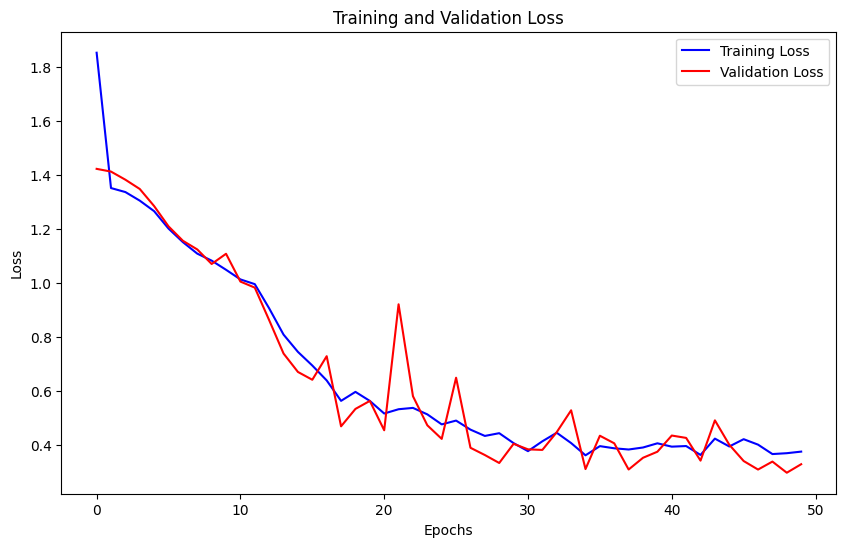

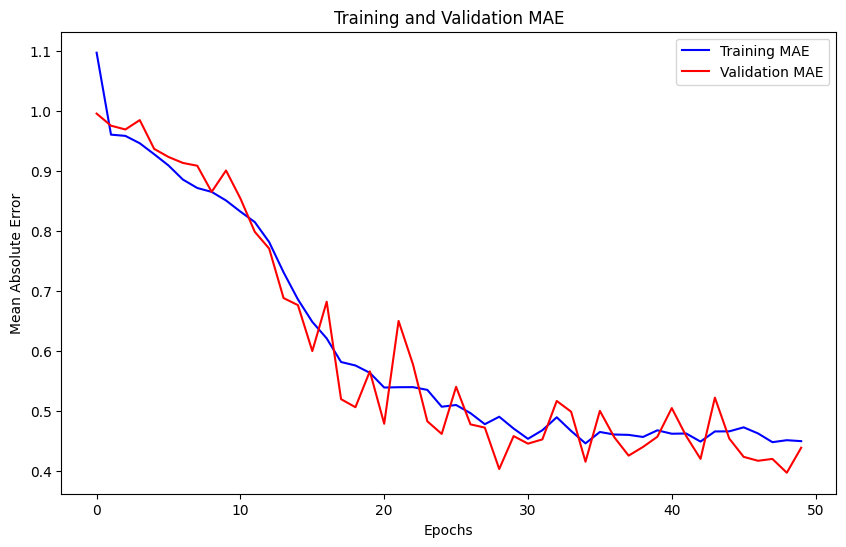

In [338]:
# Plot the loss and validation loss
plt.figure(figsize=(10, 6))

# Loss plot
plt.plot(loss, label='Training Loss', color='blue')
plt.plot(val_loss, label='Validation Loss', color='red')
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Optionally, plot MAE as well
plt.figure(figsize=(10, 6))
plt.plot(mae, label='Training MAE', color='blue')
plt.plot(val_mae, label='Validation MAE', color='red')
plt.title('Training and Validation MAE')
plt.xlabel('Epochs')
plt.ylabel('Mean Absolute Error')
plt.legend()
plt.show()


# Neural Network for Rating Prediction 📊🤖

This neural network predicts **aggregate ratings** with ~70% accuracy. Built using TensorFlow, it uses **ReLU** and **Swish** activations for better performance.

---

## Model Architecture 🏗️
- **Input Layer**: 265 neurons, ReLU activation.
- **Hidden Layers**: 128 (Swish), 64 (ReLU) neurons.
- **Output Layer**: 1 neuron, **Swish activation** (smooth, non-linear output).

---

## Why Swish? 🧠
Swish (**x * sigmoid(x)**) often outperforms ReLU by being smoother and avoiding dead neurons, making it great for deep networks.

---

## Performance 📈
- **Loss**: Mean Squared Error (MSE).
- **Metric**: Mean Absolute Error (MAE).
- **Predictions**: Continuous values (e.g., `[4.2, 3.8, 4.5]`).

---

## Conclusion 🎯
A simple yet effective model for rating prediction. Swish activation adds a modern touch for improved learning. 🚀

In [339]:
# Initialize and train the Decision Tree model
model = DecisionTreeClassifier(random_state=42)
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

In [340]:
# Calculate evaluation metrics
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

# Print the evaluation metrics
print(f"Accuracy: {accuracy:.4f}")
print("Confusion Matrix:")
print(conf_matrix)
print("Classification Report:")
print(class_report)

Accuracy: 0.6667
Confusion Matrix:
[[421   0   0   0]
 [  0  98 161  17]
 [  0 198 620 121]
 [  0  14 126 135]]
Classification Report:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       421
         2.0       0.32      0.36      0.33       276
         3.0       0.68      0.66      0.67       939
         4.0       0.49      0.49      0.49       275

    accuracy                           0.67      1911
   macro avg       0.62      0.63      0.62      1911
weighted avg       0.67      0.67      0.67      1911



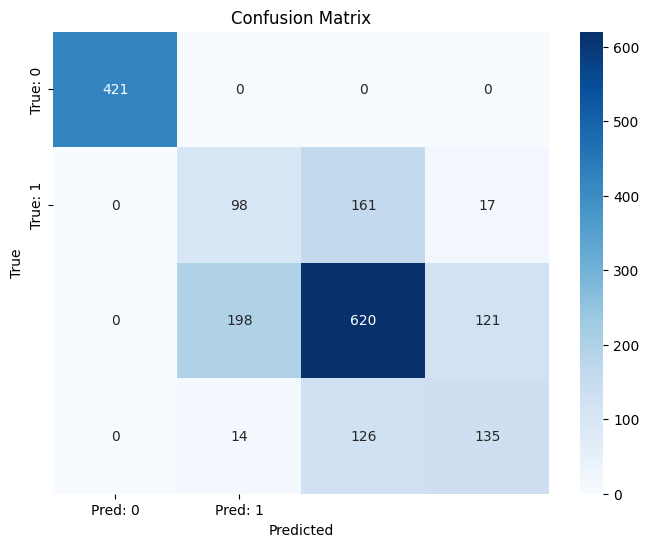

In [341]:
# Calculate the confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix using seaborn heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=["Pred: 0", "Pred: 1"], yticklabels=["True: 0", "True: 1"])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

# Decision Tree Model for Classification 🌳🎯

This **Decision Tree Classifier** achieves **66.67% accuracy** on the test set. It’s a simple yet interpretable model for predicting categorical ratings.

---

## Key Metrics 📊
- **Accuracy**: 0.6667
- **Confusion Matrix**:
  ```
  [[421   0   0   0]
   [  0  98 161  17]
   [  0 198 620 121]
   [  0  14 126 135]]
  ```
- **Classification Report**:
  - **Precision**: Ranges from 0.32 (class 2.0) to 1.00 (class 0.0).
  - **Recall**: Ranges from 0.36 (class 2.0) to 1.00 (class 0.0).
  - **F1-Score**: Ranges from 0.33 (class 2.0) to 1.00 (class 0.0).

---

## Insights 🔍
- **Class 0.0**: Perfectly predicted (100% precision, recall, and F1-score).
- **Class 2.0**: Struggles the most (low precision and recall).
- **Class 3.0**: Balanced performance (~0.68 precision and recall).
- **Class 4.0**: Moderate performance (~0.49 precision and recall).

---

## Why Decision Trees? 🌳
- **Interpretability**: Easy to visualize and understand.
- **No Scaling Needed**: Works well with raw data.
- **Non-Linear Relationships**: Captures complex patterns.

---

## Conclusion 🎯
A solid baseline model with **66.67% accuracy**. While it performs well for some classes (e.g., 0.0), it struggles with others (e.g., 2.0). Consider tuning hyperparameters or trying ensemble methods like Random Forest for better results. 🚀

In [342]:
# Initialize and train the Random Forest model
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [343]:
# Make predictions on the test set
y_pred = model.predict(X_test)

In [344]:
# Calculate evaluation metrics
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
class_report = classification_report(y_test, y_pred)

# Print the evaluation metrics
print(f"Accuracy: {accuracy:.4f}")
print("Confusion Matrix:")
print(conf_matrix)
print("Classification Report:")
print(class_report)

Accuracy: 0.6970
Confusion Matrix:
[[421   0   0   0]
 [  0  77 185  14]
 [  0 136 689 114]
 [  0  11 119 145]]
Classification Report:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       421
         2.0       0.34      0.28      0.31       276
         3.0       0.69      0.73      0.71       939
         4.0       0.53      0.53      0.53       275

    accuracy                           0.70      1911
   macro avg       0.64      0.64      0.64      1911
weighted avg       0.69      0.70      0.69      1911



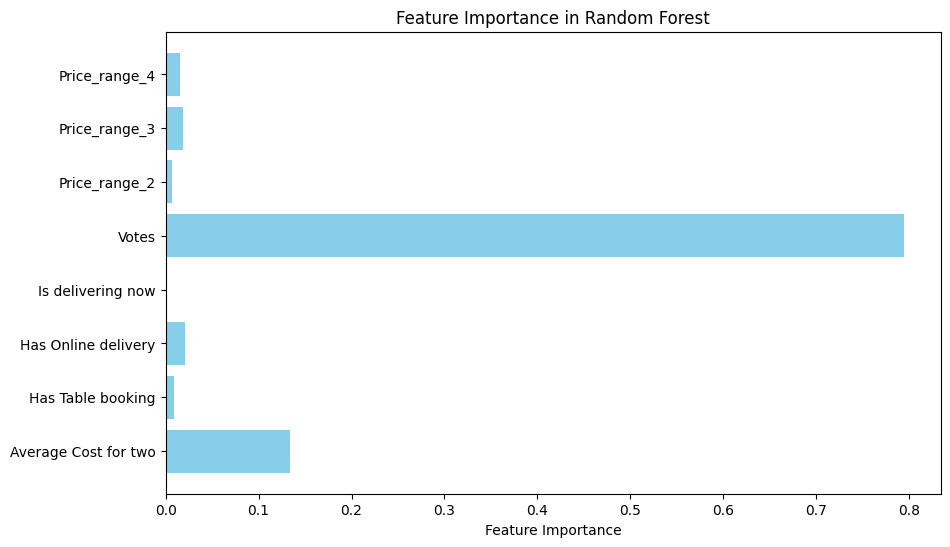

In [345]:
# Visualize Feature Importances
feature_importances = model.feature_importances_
features =X.columns
# Create a bar chart for feature importances
plt.figure(figsize=(10, 6))
plt.barh(features, feature_importances, color='skyblue')
plt.xlabel('Feature Importance')
plt.title('Feature Importance in Random Forest')
plt.show()

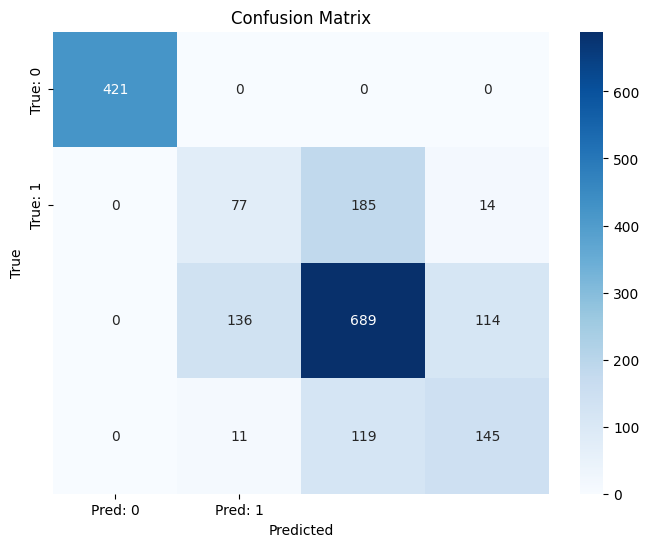

In [346]:
cm = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix using seaborn heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=["Pred: 0", "Pred: 1"], yticklabels=["True: 0", "True: 1"])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

# Random Forest Model for Classification 🌲🎯

This **Random Forest Classifier** improves accuracy to **69.70%**, outperforming the Decision Tree model. It uses an ensemble of 100 trees for better generalization.

---

## Key Metrics 📊
- **Accuracy**: 0.6970
- **Confusion Matrix**:
  ```
  [[421   0   0   0]
   [  0  77 185  14]
   [  0 136 689 114]
   [  0  11 119 145]]
  ```
- **Classification Report**:
  - **Precision**: Ranges from 0.34 (class 2.0) to 1.00 (class 0.0).
  - **Recall**: Ranges from 0.28 (class 2.0) to 1.00 (class 0.0).
  - **F1-Score**: Ranges from 0.31 (class 2.0) to 1.00 (class 0.0).

---

## Insights 🔍
- **Class 0.0**: Perfectly predicted (100% precision, recall, and F1-score).
- **Class 2.0**: Still struggles but slightly better than Decision Tree.
- **Class 3.0**: Improved performance (~0.73 recall).
- **Class 4.0**: Moderate improvement (~0.53 precision and recall).

---

## Why Random Forest? 🌲
- **Ensemble Learning**: Combines multiple trees to reduce overfitting.
- **Better Accuracy**: Outperforms single Decision Trees.
- **Robustness**: Handles noise and outliers effectively.

---

## Conclusion 🎯
With **69.70% accuracy**, Random Forest is a stronger model. While it still struggles with class 2.0, it shows improvement across other classes. For further gains, consider tuning hyperparameters (e.g., `max_depth`, `n_estimators`) or exploring advanced ensemble methods like Gradient Boosting. 🚀

In [347]:
from sklearn.ensemble import GradientBoostingClassifier

model = GradientBoostingClassifier(n_estimators=100, random_state=42)

model.fit(X_train, y_train)

y_pred = model.predict(X_test)

In [348]:
# Calculate evaluation metrics
# Best performing algorithm
accuracy = accuracy_score(y_test, y_pred)

conf_matrix = confusion_matrix(y_test, y_pred)

class_report = classification_report(y_test, y_pred)

# Print the evaluation metrics

print(f"Accuracy: {accuracy:.4f}")

print("Confusion Matrix:")
print(conf_matrix)

print("Classification Report:")
print (class_report)


Accuracy: 0.7588
Confusion Matrix:
[[421   0   0   0]
 [  0  18 256   2]
 [  0  17 864  58]
 [  0   0 128 147]]
Classification Report:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       421
         2.0       0.51      0.07      0.12       276
         3.0       0.69      0.92      0.79       939
         4.0       0.71      0.53      0.61       275

    accuracy                           0.76      1911
   macro avg       0.73      0.63      0.63      1911
weighted avg       0.74      0.76      0.71      1911



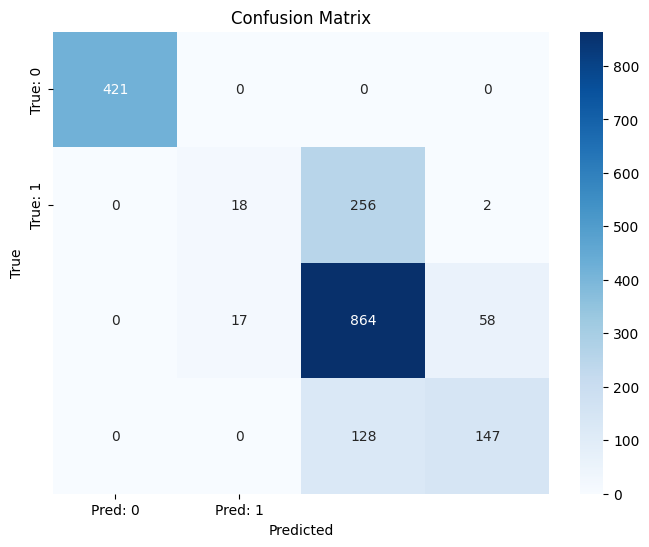

In [349]:
# Calculate the confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix using seaborn heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=["Pred: 0", "Pred: 1"], yticklabels=["True: 0", "True: 1"])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

# Gradient Boosting Model for Classification 🚀🏆

This **Gradient Boosting Classifier** achieves the **highest accuracy of 75.88%**, making it the best-performing model so far. It uses an ensemble of 100 sequential trees to minimize errors and improve predictions.

---

## Key Metrics 📊
- **Accuracy**: 0.7588
- **Confusion Matrix**:
  ```
  [[421   0   0   0]
   [  0  18 256   2]
   [  0  17 864  58]
   [  0   0 128 147]]
  ```
- **Classification Report**:
  - **Precision**: Ranges from 0.51 (class 2.0) to 1.00 (class 0.0).
  - **Recall**: Ranges from 0.07 (class 2.0) to 1.00 (class 0.0).
  - **F1-Score**: Ranges from 0.12 (class 2.0) to 1.00 (class 0.0).

---

## Insights 🔍
- **Class 0.0**: Perfectly predicted (100% precision, recall, and F1-score).
- **Class 2.0**: Still struggles significantly (low recall of 0.07).
- **Class 3.0**: Excellent performance (~0.92 recall).
- **Class 4.0**: Moderate performance (~0.53 recall).

---

## Why Gradient Boosting? 🌟
- **Sequential Learning**: Builds trees sequentially to correct errors from previous trees.
- **High Accuracy**: Outperforms both Decision Trees and Random Forests.
- **Flexibility**: Handles complex patterns and interactions in data.

---

## Conclusion 🎯
With **75.88% accuracy**, Gradient Boosting is the **best-performing model** in this comparison. While it excels for classes 0.0 and 3.0, it still struggles with class 2.0. For further improvements, consider hyperparameter tuning (e.g., learning rate, tree depth) or exploring advanced techniques like XGBoost or LightGBM. 🚀🔥

# Task 2

In [355]:
from sklearn.metrics.pairwise import cosine_similarity

def calculate_restaurant_similarity(data, user_preferences, n_recommendations=10):
    """
    Calculate restaurant similarity scores based on user preferences
    
    Parameters:
    data: DataFrame with restaurant features
    user_preferences: dict with preferred values for features
    n_recommendations: number of recommendations to return
    """
    # Select features for similarity calculation
    features = [
        'Average Cost for two',
        'Has Table booking',
        'Has Online delivery',
        'Is delivering now',
        'Aggregate rating',
        'Price_range_2',
        'Price_range_3',
        'Price_range_4'
    ]
    
    # Normalize numerical features
    scaler = MinMaxScaler()
    
    # Create a copy of the data for processing
    restaurant_features = data[features].copy()
    
    # Normalize 'Average Cost for two' and 'Aggregate rating'
    restaurant_features['Average Cost for two'] = scaler.fit_transform(
        restaurant_features[['Average Cost for two']])
    
    # Convert user preferences to feature vector
    user_vector = np.zeros(len(features))
    
    for i, feature in enumerate(features):
        if feature in user_preferences:
            user_vector[i] = user_preferences[feature]
    
    # Calculate similarity scores
    similarity_scores = cosine_similarity([user_vector], restaurant_features)
    
    # Create recommendations DataFrame
    recommendations = pd.DataFrame({
        'Restaurant_ID': data.index,
        'Average_Cost': data['Average Cost for two'],
        'Rating': data['Aggregate rating'],
        'Has_Table_Booking': data['Has Table booking'],
        'Similarity_Score': similarity_scores[0]
    })
    
    # Sort by similarity score
    recommendations = recommendations.sort_values(
        'Similarity_Score', 
        ascending=False
    ).head(n_recommendations)
    
    return recommendations

def display_recommendations(recommendations):
    """
    Display recommendations in a formatted way
    """
    print("\n🍽️ Top Restaurant Recommendations:\n")
    
    for idx, row in recommendations.iterrows():
        print(f"🏪 Restaurant ID: {row['Restaurant_ID']}")
        print(f"💰 Average Cost: {row['Average_Cost']*800000}")
        print(f"⭐ Rating: {row['Rating']}/5.0")
        print(f"📑 Table Booking: {'Yes' if row['Has_Table_Booking'] else 'No'}")
        print(f"🎯 Similarity Score: {row['Similarity_Score']:.4f}")
        print("-" * 40)
    
    # Print summary statistics
    print("\n📊 Summary Statistics:")
    print(f"Average Similarity Score: {recommendations['Similarity_Score'].mean():.4f}")
    print(f"Average Cost of Recommendations: {recommendations['Average_Cost'].mean():.2f}")
    print(f"Average Rating: {recommendations['Rating'].mean():.2f}")


In [356]:
# Define preferences
preferences = {
    'Average Cost for two': 300,
    'Has Table booking': 1,
    'Aggregate rating': 3.0,
    'Price_range_3': 1
}

# Get recommendations
recs = calculate_restaurant_similarity(data, preferences)
display_recommendations(recs)


🍽️ Top Restaurant Recommendations:

🏪 Restaurant ID: 2094.0
💰 Average Cost: 250.0
⭐ Rating: 0.0/5.0
📑 Table Booking: No
🎯 Similarity Score: 0.9999
----------------------------------------
🏪 Restaurant ID: 2095.0
💰 Average Cost: 150.0
⭐ Rating: 0.0/5.0
📑 Table Booking: No
🎯 Similarity Score: 0.9999
----------------------------------------
🏪 Restaurant ID: 2096.0
💰 Average Cost: 300.0
⭐ Rating: 0.0/5.0
📑 Table Booking: No
🎯 Similarity Score: 0.9999
----------------------------------------
🏪 Restaurant ID: 2035.0
💰 Average Cost: 250.0
⭐ Rating: 0.0/5.0
📑 Table Booking: No
🎯 Similarity Score: 0.9999
----------------------------------------
🏪 Restaurant ID: 2004.0
💰 Average Cost: 300.0
⭐ Rating: 0.0/5.0
📑 Table Booking: No
🎯 Similarity Score: 0.9999
----------------------------------------
🏪 Restaurant ID: 2005.0
💰 Average Cost: 200.0
⭐ Rating: 0.0/5.0
📑 Table Booking: No
🎯 Similarity Score: 0.9999
----------------------------------------
🏪 Restaurant ID: 2006.0
💰 Average Cost: 100.0
⭐ Rat